In [53]:
# cell 1 —

!pip -q install --upgrade torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
!pip -q install datasets==3.0.1 timm==1.0.9 matplotlib==3.8.4 pandas==2.2.2 scikit-learn==1.5.2 tqdm==4.66.5

import os, math, random, warnings
from pathlib import Path

# silence everything ugly
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)
os.environ["PYTHONWARNINGS"] = "ignore"

import torch
torch.multiprocessing.set_sharing_strategy("file_system")

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from torchvision.models import resnet18, resnet50, ResNet18_Weights, ResNet50_Weights
from datasets import load_dataset
import numpy as np, pandas as pd
from sklearn.metrics import accuracy_score
from tqdm.auto import tqdm
import matplotlib
import matplotlib.pyplot as plt

# reproducibility
SEED = 27100162
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# config
CFG = {
    "dataset_name": "flwrlabs/pacs",
    "domains": ["art_painting", "cartoon", "photo", "sketch"],
    "target_domain": "sketch",
    "source_domains": ["art_painting", "cartoon", "photo"],
    "num_classes": 7,
    "image_size": 224,
    "batch_size": 64,
    "num_workers": 0,          # <── prevents multiprocessing spam
    "pin_memory": True,
    "backbone": "resnet18",
    "finetune_all": True,
    "epochs": {"ERM": 12, "IRM": 20, "DRO": 14, "SAM": 12},
    "opt": {"lr": 2e-4, "weight_decay": 1e-4, "betas": (0.9, 0.999)},
    "sched": {"use_cosine": True, "min_lr": 1e-6},
    "irm": {"penalty_weight": 1e2, "anneal_iters": 100},
    "dro": {"eta": 0.02},
    "sam": {"rho": 0.05},
    "aug": {"color_jitter": True, "random_grayscale": True, "random_horizontal_flip": True},
    "save_dir": "outputs/PACS_Task2",
    "mixed_precision": True
}

# dirs
os.makedirs(CFG["save_dir"], exist_ok=True)
os.makedirs(os.path.join(CFG["save_dir"], "figs"), exist_ok=True)
os.makedirs(os.path.join(CFG["save_dir"], "ckpts"), exist_ok=True)
os.makedirs(os.path.join(CFG["save_dir"], "logs"), exist_ok=True)

# clean plotting style (no Times New Roman nonsense)
matplotlib.rcParams.update({
    "figure.dpi": 100,
    "savefig.dpi": 600,
    "font.family": "DejaVu Serif",   # safe default
    "axes.titlesize": 16,
    "axes.labelsize": 14,
    "xtick.labelsize": 12,
    "ytick.labelsize": 12,
    "legend.fontsize": 12,
    "axes.linewidth": 1.2
})


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
umap-learn 0.5.9.post2 requires scikit-learn>=1.6, but you have scikit-learn 1.5.2 which is incompatible.


In [54]:
#cell 2

LOCAL_ZIP = "PACS.zip"  #set to path of your uploaded zip, e.g., "/content/PACS.zip"; leave empty to use HuggingFace
# i have provided the zip file by myself for pacs
import torchvision

from torchvision.datasets import ImageFolder  # for local PACS folder reading
import zipfile# to extract zip
import shutil  # to remove dirs if needed

#uild transforms
def build_transforms(image_size, is_train, aug_cfg):
    t = []  # list of transforms
    if is_train:  # training pipeline
        t.append(transforms.Resize(int(image_size * 1.15)))  # slightly enlarge
        t.append(transforms.RandomResizedCrop(image_size, scale=(0.7, 1.0)))  # random crop
        if aug_cfg["random_horizontal_flip"]:  # optional flip
            t.append(transforms.RandomHorizontalFlip(p=0.5))  # flip half images
        if aug_cfg["color_jitter"]:  # color jitter
            t.append(transforms.ColorJitter(0.2, 0.2, 0.2, 0.1))  # mild jitter
        if aug_cfg["random_grayscale"]:  # grayscale
            t.append(transforms.RandomGrayscale(p=0.1))  # random grayscale
    else:  # eval pipeline
        t.append(transforms.Resize(int(image_size * 1.15)))  # resize
        t.append(transforms.CenterCrop(image_size))  # center crop
    t.append(transforms.ToTensor())  # tensor
    t.append(transforms.Normalize(mean=[0.485, 0.456, 0.406],  # ImageNet mean
                                  std=[0.229, 0.224, 0.225]))  # ImageNet std
    return transforms.Compose(t)  # compose

#Dataset wrapper for HF split
class HFImageDataset(Dataset):
    def __init__(self, hf_split, transform, domain_name):
        self.hf_split = hf_split  # HF dataset
        self.transform = transform  # transform pipeline
        self.domain_name = domain_name  # domain id string

    def __len__(self):
        return len(self.hf_split)  # length

    def __getitem__(self, idx):
        ex = self.hf_split[idx]  # fetch example
        img = ex["image"] # PIL image
        y = int(ex["label"])
        x = self.transform(img)  # transform
        domain_to_int = {d: i for i, d in enumerate(CFG["domains"])}  # domain map
        d = domain_to_int[self.domain_name]
        return x, y, d

#Build loaders-either from local zip or from HF datasets
def make_domain_loaders_from_local(root_dir, image_size, batch_size, num_workers, pin_memory, aug_cfg, val_ratio=0.15):
    #this function builds per-domain ImageFolder datasets assuming:
    # root_dir/domain_name/class_name/*.jpg structure.
    t_train = build_transforms(image_size, True, aug_cfg)  # train transforms
    t_eval  = build_transforms(image_size, False, aug_cfg)  # eval transforms

    domain_loaders = {}  # dict of loaders per domain
    for dom in CFG["domains"]:  # loop domains
        dom_path = os.path.join(root_dir, dom)  # domain folder
        # Load entire domain to split ourselves
        full_ds = ImageFolder(dom_path, transform=None)  # raw dataset
        n = len(full_ds)  # size
        idx = np.random.RandomState(SEED).permutation(n)  # deterministic perm
        n_val = int(val_ratio * n)  # val size
        val_idx = set(idx[:n_val].tolist())  # val indices
        # Build subsets
        train_samples = [full_ds.samples[i] for i in range(n) if i not in val_idx]  # train paths
        val_samples   = [full_ds.samples[i] for i in range(n) if i in val_idx]  # val paths

        class LocalSubset(Dataset):
            def __init__(self, samples, transform, domain_name):
                self.samples = samples  # list of (path, label)
                self.transform = transform  # transform
                self.domain_name = domain_name  # domain
            def __len__(self):
                return len(self.samples)
            def __getitem__(self, i):
                path, y = self.samples[i]
                img = torchvision.io.read_image(path).float() / 255.0  # tensor image in [0,1]
                img = transforms.ToPILImage()(img)  # convert to PIL for same pipeline
                x = self.transform(img)  # transform
                domain_to_int = {d: i for i, d in enumerate(CFG["domains"])}
                d = domain_to_int[self.domain_name]
                return x, int(y), d
        # Construct datasets
        ds_train = LocalSubset(train_samples, t_train, dom)
        ds_val = LocalSubset(val_samples,t_eval,  dom)
        # Loaders
        domain_loaders[dom] = {
            "train": DataLoader(ds_train, batch_size=batch_size, shuffle=True, drop_last=True,
                                num_workers=num_workers, pin_memory=pin_memory),  # train loader
            "val":   DataLoader(ds_val,   batch_size=batch_size, shuffle=False, drop_last=False,
                                num_workers=num_workers, pin_memory=pin_memory)   # val loader
        }

    #merge ERM
    erm_train_parts = [domain_loaders[d]["train"].dataset for d in CFG["source_domains"]]  # datasets
    erm_concat = torch.utils.data.ConcatDataset(erm_train_parts)  # concat dataset
    erm_loader = DataLoader(erm_concat, batch_size=batch_size, shuffle=True, drop_last=True,
                            num_workers=num_workers, pin_memory=pin_memory)  # merged loader
    return domain_loaders, erm_loader  # return dict and ERM loader

def make_domain_loaders_from_hf(hf_dataset, image_size, batch_size, num_workers, pin_memory, aug_cfg, val_ratio=0.15):
    #Split HF dataset by domain to build per-domain loaders
    domain_splits = {}  # tmp splits
    for dom in CFG["domains"]:  # loop domains
        dom_split = hf_dataset.filter(lambda ex: ex["domain"] == dom)  # filter by domain
        n = len(dom_split)  # count
        n_val = int(val_ratio * n)  # val size
        idx = np.random.RandomState(SEED).permutation(n)  # deterministic perm
        val_idx = set(idx[:n_val].tolist())  # val set
        dom_train = dom_split.select([i for i in range(n) if i not in val_idx])  # train part
        dom_val   = dom_split.select([i for i in range(n) if i in val_idx])  # val part
        domain_splits[dom] = {"train": dom_train, "val": dom_val}  # store

    t_train = build_transforms(image_size, True, aug_cfg)  # train transforms
    t_eval  = build_transforms(image_size, False, aug_cfg)  # eval transforms

    domain_loaders = {}  # loaders per domain
    for dom, splits in domain_splits.items():  # loop domain splits
        ds_train = HFImageDataset(splits["train"], t_train, dom)  # HF train
        ds_val   = HFImageDataset(splits["val"],   t_eval,  dom)  # HF val
        domain_loaders[dom] = {  # loaders
            "train": DataLoader(ds_train, batch_size=batch_size, shuffle=True, drop_last=True,
                                num_workers=num_workers, pin_memory=pin_memory),  # train loader
            "val":   DataLoader(ds_val,   batch_size=batch_size, shuffle=False, drop_last=False,
                                num_workers=num_workers, pin_memory=pin_memory)   # val loader
        }

    #ERM merged train
    erm_train_parts = [domain_loaders[d]["train"].dataset for d in CFG["source_domains"]]  # datasets
    erm_concat = torch.utils.data.ConcatDataset(erm_train_parts)  # concat dataset
    erm_loader = DataLoader(erm_concat, batch_size=batch_size, shuffle=True, drop_last=True,
                            num_workers=num_workers, pin_memory=pin_memory)  # merged loader
    return domain_loaders, erm_loader  # return

#hoose source: local zip or HF dataset
if LOCAL_ZIP:  # use local zip if provided
    extract_dir = "/content/PACS_local"  # extraction dir
    if os.path.exists(extract_dir):  # clean previous if exists
        shutil.rmtree(extract_dir)  # remove
    os.makedirs(extract_dir, exist_ok=True)  # create
    with zipfile.ZipFile(LOCAL_ZIP, 'r') as zf:  # open zip
        zf.extractall(extract_dir)  # extract all


    root_dir = "/content/PACS_local/kfold"  # set root to extraction folder
    domain_loaders, erm_loader = make_domain_loaders_from_local(root_dir,
                                                                CFG["image_size"], CFG["batch_size"],
                                                                CFG["num_workers"], CFG["pin_memory"], CFG["aug"])
else:  # fallback to HuggingFace
    hf_ds = load_dataset(CFG["dataset_name"])["train"]  # load HF PACS
    domain_loaders, erm_loader = make_domain_loaders_from_hf(hf_ds,
                                                             CFG["image_size"], CFG["batch_size"],
                                                             CFG["num_workers"], CFG["pin_memory"], CFG["aug"])

#Target eval loader
target_eval_loader = domain_loaders[CFG["target_domain"]]["val"]# held-out target val

# Source domain val loaders
source_val_loaders = {d:domain_loaders[d]["val"] for d in CFG["source_domains"]}  # dict of source val loaders


In [55]:
#cell 3

def create_model(backbone_name, num_classes, finetune_all=True):
    if backbone_name == "resnet18":  #esNet-18
        weights = ResNet18_Weights.IMAGENET1K_V1  # ImageNet weights
        net = resnet18(weights=weights)  #load model
        in_features = net.fc.in_features# head in-dim
    elif backbone_name == "resnet50": #ResNet-50
        weights = ResNet50_Weights.IMAGENET1K_V2  #ImageNet weights
        net = resnet50(weights=weights)
        in_features = net.fc.in_features
    else:
        raise ValueError("unsupported backbone; use 'resnet18' or 'resnet50'")

    net.fc = nn.Linear(in_features, num_classes)  #replace classifier head

    if not finetune_all: # freeze backboneif partial finetune
        for p in net.parameters():  # loop params
            p.requires_grad = False #freeze
        for p in net.fc.parameters(): #unfreeze head
            p.requires_grad = True

    net = net.to(DEVICE)
    params = [p for p in net.parameters() if p.requires_grad]
    return net, params

In [56]:
#cell 4

def accuracy_from_logits(logits, y):
    preds = logits.argmax(dim=1)  #argmax class
    return (preds == y).float().mean().item()# mean accuracy

@torch.no_grad()
def evaluate(model, loader):
    model.eval()  #eval mode
    total_correct = 0#correct count
    total_seen = 0  #sample count
    for x, y, _ in loader:  # iterate
        x = x.to(DEVICE, non_blocking=True)
        y = y.to(DEVICE, non_blocking=True)
        logits = model(x)
        preds = logits.argmax(dim=1)
        total_correct += (preds == y).sum().item()
        total_seen += y.size(0)
    return total_correct / max(1, total_seen)

@torch.no_grad()
def evaluate_per_domain(model, domain_val_loaders):
    model.eval()
    results = {}
    for dom, loader in domain_val_loaders.items():
        results[dom] = evaluate(model, loader)
    return results #dict

def worst_domain_accuracy(acc_dict):
    return float("nan") if len(acc_dict) == 0 else float(min(acc_dict.values()))  # worst-case

def save_checkpoint(model, optimizer, step_or_epoch, path):
    state = {  #state dict
        "model": model.state_dict(),  #weights
        "optimizer": optimizer.state_dict(),  #opt state
        "step_or_epoch": step_or_epoch,  #marker
        "cfg": CFG  #config sss
    }
    torch.save(state, path)

# def worst_domain_accuracy(acc_dict):
#     return float("nan") if len(acc_dict) == 0 else float(min(acc_dict.values()))  # worst-case

# def save_checkpoint(model, optimizer, step_or_epoch, path):
#     state = {  #state dict
#         "model": model.state_dict(),  #weights
#         "optimizer": optimizer.state_dict(),  #opt state
#         "step_or_epoch": step_or_epoch,  #marker
#         "cfg": CFG  #config sss
#     }
#     torch.save(state, path)


def load_checkpoint(path, model, optimizer=None, strict=True):
    ckpt = torch.load(path, map_location=DEVICE)
    model.load_state_dict(ckpt["model"], strict=strict)  # restore weights
    if optimizer is not None and "optimizer" in ckpt:
        optimizer.load_state_dict(ckpt["optimizer"])
    return ckpt.get("step_or_epoch", None)

def build_scheduler(optimizer, total_steps, min_lr, use_cosine=True):
    if not use_cosine:
        return optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lambda _: 1.0)
    def lr_lambda(step):  # cosine decay
        cos_out = 0.5 * (1 + math.cos(math.pi * step / total_steps))  # cosine factor
        return (CFG["sched"]["min_lr"] / CFG["opt"]["lr"]) + (1 - (CFG["sched"]["min_lr"] / CFG["opt"]["lr"])) * cos_out  # scaled
    return optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

In [57]:
#cell 5
#IRM HELPERS: IRMV1 PENALTY AND MULTI DOMAIN ITERATOR


def irm_penalty(logits, y):
    scale = torch.tensor(1.0, device=logits.device, requires_grad=True)  # scalar
    loss = F.cross_entropy(logits * scale, y)  # CE on scaled logits
    grad = torch.autograd.grad(loss, [scale], create_graph=True)[0]  # dL/dscale
    return grad.pow(2).sum()  #squared grad

def domain_batch_iter(loaders):
    iters = {k: iter(v) for k, v in loaders.items()}
    while True:
        batch_dict = {}
        for k, v in loaders.items():
            try:
                batch_dict[k] = next(iters[k])
            except StopIteration:
                iters[k] = iter(v)  # re-init exhausted iterator
                batch_dict[k] = next(iters[k])
        yield batch_dict

In [58]:
#cell 6
# SAM OPTIMIZER
# class SAM(optim.Optimizer):
#     def __init__(self, params, base_optimizer, rho=0.05, adaptive=False, **kwargs):
#         if rho <= 0.0:  # sanitycheck
#             raise ValueError("Rrho must be +ve")
#         self.rho = rho  # radius
#         self.adaptive = adaptive
#         defaults = dict(rho=rho, adaptive=adaptive, **kwargs)  # defaults
#         super().__init__(params, defaults)
#         self.base_optimizer = base_optimizer(self.param_groups, **kwargs)

#     @torch.no_grad()
#     def first_step(self):
#         grad_norm = self._grad_norm()# global norm
#         for group in self.param_groups: #param groups
#             scale = self.rho / (grad_norm + 1e-12)
#             for p in group["params"]:  #each param
#                 if p.grad is None:
#                     continue
#                 e_w = (p.abs() if self.adaptive else 1.0) * p.grad  # direction
#                 p.add_(e_w, alpha=scale)  #perturb in-place
#         self.zero_grad(set_to_none=True)  #clear grads

#     @torch.no_grad()
#     def second_step(self):
#         self.base_optimizer.step()  #update inner opt
#         self.zero_grad(set_to_none=True)  #clear

#     def _grad_norm(self):
#         shared_device = self.param_groups[0]["params"][0].device  #device
#         norms = []  #collect norms
#         for group in self.param_groups:
#             for p in group["params"]:
#                 if p.grad is None:
#                     continue
#                 g = p.grad.detach()
#                 scale = (p.abs() if self.adaptive else 1.0)
#                 norms.append((scale * g).norm(p=2))  # L2 norm
#         if not norms:
#             return torch.tensor(0., device=shared_device)
#         return torch.norm(torch.stack(norms), p=2).to(shared_device)  # global L2
class SAM(optim.Optimizer):
    def __init__(self, params, base_optimizer, rho=0.05, adaptive=False, **kwargs):
        if rho <= 0.0:
            raise ValueError("rho must be positive")
        defaults = dict(rho=rho, adaptive=adaptive, **kwargs)
        super().__init__(params, defaults)
        self.base_optimizer = base_optimizer(self.param_groups, **kwargs)
        self.rho = rho
        self.adaptive = adaptive

    @torch.no_grad()
    def first_step(self):
        # compute global grad norm
        shared_device = self.param_groups[0]["params"][0].device
        grad_norm = torch.norm(torch.stack([
            ((p.abs() if self.adaptive else 1.0) * p.grad).norm(p=2)
            for group in self.param_groups for p in group["params"]
            if p.grad is not None
        ]), p=2).to(shared_device)

        scale = self.rho / (grad_norm + 1e-12)
        # save perturbation and move to SAM point
        for group in self.param_groups:
            for p in group["params"]:
                if p.grad is None:
                    continue
                e_w = ((p.abs() if self.adaptive else 1.0) * p.grad) * scale
                if "e_w" not in self.state[p]:
                    self.state[p]["e_w"] = torch.zeros_like(p)
                self.state[p]["e_w"].copy_(e_w)
                p.add_(e_w)

    @torch.no_grad()
    def second_step(self):
        # step at perturbed point, then restore clean weights
        self.base_optimizer.step()
        for group in self.param_groups:
            for p in group["params"]:
                if "e_w" in self.state[p]:
                    p.sub_(self.state[p]["e_w"])
        self.zero_grad(set_to_none=True)

    @torch.no_grad()
    def zero_grad(self, set_to_none=True):
        self.base_optimizer.zero_grad(set_to_none=set_to_none)

    @torch.no_grad()
    def restore(self):
        # subtract the stored perturbation to go back to the original weights
        for group in self.param_groups:
            for p in group["params"]:
                e_w = p.state.get("e_w", None)
                if e_w is not None:
                    p.sub_(e_w)
                    p.state["e_w"] = None

    def _grad_norm(self):
        shared_device = self.param_groups[0]["params"][0].device  #device
        norms = []  #collect norms
        for group in self.param_groups:
            for p in group["params"]:
                if p.grad is None:
                    continue
                g = p.grad.detach()
                scale = (p.abs() if self.adaptive else 1.0)
                norms.append((scale * g).norm(p=2))  # L2 norm
        if not norms:
            return torch.tensor(0., device=shared_device)
        return torch.norm(torch.stack(norms), p=2).to(shared_device)  # global L2


In [59]:
# pagedir_t *vmm_create_address_space(void){

#     void *pd_phys = kmm_frame_alloc(); // ask kmm for a 4kib frame for dir
#     if (!pd_phys){
#         return NULL;
#     }

#     pagedir_t *pd = (pagedir_t *)PHYS_TO_VIRT(pd_phys);
#     //mmset(pd, 0, sizeof(pagedir_t));      // no WAY I MADE ERROR ON THIS
#     memset(pd, 0, sizeof(pagedir_t));
#     return pd;
# }

In [60]:
#cell 7
# TRAINIG ERM , IRM , GROUPDROP, SAM WITH CHECKPTS
# note that i have added checkpoitns to save re-training time
RESUME_IF_CKPT_EXISTS = True
from torch import amp

def _latest_ckpt(prefix):
    ckpt_dir = os.path.join(CFG["save_dir"], "ckpts")
    if not os.path.isdir(ckpt_dir):
        return None
    files = [f for f in os.listdir(ckpt_dir) if f.startswith(prefix) and f.endswith(".pt")]
    if not files:
        return None
    pairs = []
    for f in files:
        try:
            num = int(''.join(ch for ch in f.split("epoch")[-1] if ch.isdigit()))
            pairs.append((num, os.path.join(ckpt_dir, f)))
        except:
            pass
    if not pairs:
        return None
    pairs.sort(key=lambda x: x[0])
    return pairs[-1][1]

def forward_backward_step(model, optimizer, scaler, batch_x, batch_y):
    optimizer.zero_grad(set_to_none=True)
    with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
        logits = model(batch_x)
        loss = F.cross_entropy(logits, batch_y)
    scaler.scale(loss).backward()
    scaler.step(optimizer)
    scaler.update()
    return loss.detach().item()

def train_ERM(domain_loaders, erm_loader):
    prefix = "ERM_"
    latest = _latest_ckpt(prefix)
    model, params = create_model(CFG["backbone"], CFG["num_classes"], CFG["finetune_all"])
    optimizer = optim.AdamW(params, lr=CFG["opt"]["lr"], weight_decay=CFG["opt"]["weight_decay"], betas=CFG["opt"]["betas"])
    scaler = torch.cuda.amp.GradScaler(enabled=CFG["mixed_precision"])

    if RESUME_IF_CKPT_EXISTS and latest:
        load_checkpoint(latest, model, optimizer)
        print(f"[ERM] Loaded checkpoint: {latest}")
        return model

    total_steps = CFG["epochs"]["ERM"] * len(erm_loader)
    scheduler = build_scheduler(optimizer, total_steps, CFG["sched"]["min_lr"], CFG["sched"]["use_cosine"])

    logs, step = [], 0
    for epoch in range(1, CFG["epochs"]["ERM"] + 1):
        model.train()
        running_loss = 0.0
        for x, y, _ in tqdm(erm_loader, desc=f"ERM epoch {epoch}", leave=False):
            x = x.to(DEVICE, non_blocking=True); y = y.to(DEVICE, non_blocking=True)
            loss_val = forward_backward_step(model, optimizer, scaler, x, y)
            running_loss += loss_val
            scheduler.step(); step += 1
        target_acc = evaluate(model, target_eval_loader)
        src_accs = evaluate_per_domain(model, source_val_loaders)
        worst_src = worst_domain_accuracy(src_accs)
        avg_src = float(np.mean(list(src_accs.values())))
        logs.append({
            "epoch": epoch,
            "train_loss": running_loss / max(1, len(erm_loader)),
            "target_acc": target_acc,
            "worst_source_acc": worst_src,
            "avg_source_acc": avg_src,
            **{f"src_{k}_acc": v for k, v in src_accs.items()}
        })
        ckpt_path = os.path.join(CFG["save_dir"], "ckpts", f"{prefix}epoch{epoch}.pt")
        save_checkpoint(model, optimizer, epoch, ckpt_path)
    pd.DataFrame(logs).to_csv(os.path.join(CFG["save_dir"], "logs", "ERM_logs.csv"), index=False)
    return model

def train_IRM(domain_loaders):
    prefix = "IRM_"
    latest = _latest_ckpt(prefix)
    model, params = create_model(CFG["backbone"], CFG["num_classes"], CFG["finetune_all"])
    optimizer = optim.AdamW(params, lr=CFG["opt"]["lr"], weight_decay=CFG["opt"]["weight_decay"], betas=CFG["opt"]["betas"])
    scaler = torch.cuda.amp.GradScaler(enabled=CFG["mixed_precision"])

    if RESUME_IF_CKPT_EXISTS and latest:
        load_checkpoint(latest, model, optimizer)
        print(f"[IRM] Loaded checkpoint: {latest}")
        return model

    src_train_loaders = {d: domain_loaders[d]["train"] for d in CFG["source_domains"]}
    steps_per_epoch = min(len(dl) for dl in src_train_loaders.values())
    total_steps = CFG["epochs"]["IRM"] * steps_per_epoch
    scheduler = build_scheduler(optimizer, total_steps, CFG["sched"]["min_lr"], CFG["sched"]["use_cosine"])

    logs, multi_iter, step = [], domain_batch_iter(src_train_loaders), 0
    for epoch in range(1, CFG["epochs"]["IRM"] + 1):
        model.train()
        running_loss, running_pen = 0.0, 0.0
        for _ in tqdm(range(steps_per_epoch), desc=f"IRM epoch {epoch}", leave=False):
            batch_dict = next(multi_iter)
            total_ce, total_penalty = 0.0, 0.0
            optimizer.zero_grad(set_to_none=True)
            for dom, (x, y, d) in batch_dict.items():
                x = x.to(DEVICE, non_blocking=True); y = y.to(DEVICE, non_blocking=True)
                with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
                    logits = model(x)
                    ce = F.cross_entropy(logits, y)
                pen = irm_penalty(logits, y)
                total_ce = total_ce + ce
                total_penalty = total_penalty + pen
            penalty_weight = CFG["irm"]["penalty_weight"] if step >= CFG["irm"]["anneal_iters"] else (CFG["irm"]["penalty_weight"] * 0.1)
            total_loss = total_ce / len(batch_dict) + penalty_weight * (total_penalty / len(batch_dict))
            scaler.scale(total_loss).backward()
            scaler.step(optimizer)
            scaler.update()
            scheduler.step(); step += 1
            running_loss += (total_ce / len(batch_dict)).detach().item()
            running_pen  += (total_penalty / len(batch_dict)).detach().item()
        target_acc = evaluate(model, target_eval_loader)
        src_accs = evaluate_per_domain(model, source_val_loaders)
        worst_src = worst_domain_accuracy(src_accs)
        avg_src = float(np.mean(list(src_accs.values())))
        logs.append({
            "epoch": epoch,
            "train_ce": running_loss / max(1, steps_per_epoch),
            "irm_penalty": running_pen / max(1, steps_per_epoch),
            "target_acc": target_acc,
            "worst_source_acc": worst_src,
            "avg_source_acc": avg_src,
            **{f"src_{k}_acc": v for k, v in src_accs.items()}
        })
        ckpt_path = os.path.join(CFG["save_dir"], "ckpts", f"{prefix}epoch{epoch}.pt")
        save_checkpoint(model, optimizer, epoch, ckpt_path)
    pd.DataFrame(logs).to_csv(os.path.join(CFG["save_dir"], "logs", "IRM_logs.csv"), index=False)
    return model

def train_GroupDRO(domain_loaders):
    prefix = "DRO_"
    latest = _latest_ckpt(prefix)
    model, params = create_model(CFG["backbone"], CFG["num_classes"], CFG["finetune_all"])
    optimizer = optim.AdamW(params, lr=CFG["opt"]["lr"], weight_decay=CFG["opt"]["weight_decay"], betas=CFG["opt"]["betas"])
    scaler = torch.cuda.amp.GradScaler(enabled=CFG["mixed_precision"])

    if RESUME_IF_CKPT_EXISTS and latest:
        load_checkpoint(latest, model, optimizer)
        print(f"[DRO] Loaded checkpoint: {latest}")
        return model

    src_train_loaders = {d: domain_loaders[d]["train"] for d in CFG["source_domains"]}
    steps_per_epoch = min(len(dl) for dl in src_train_loaders.values())
    total_steps = CFG["epochs"]["DRO"] * steps_per_epoch
    scheduler = build_scheduler(optimizer, total_steps, CFG["sched"]["min_lr"], CFG["sched"]["use_cosine"])

    domains = list(src_train_loaders.keys())
    w = torch.ones(len(domains), device=DEVICE) / len(domains)

    logs, weights_history, multi_iter, step = [], [], domain_batch_iter(src_train_loaders), 0
    for epoch in range(1, CFG["epochs"]["DRO"] + 1):
        model.train()
        running_loss = 0.0
        for _ in tqdm(range(steps_per_epoch), desc=f"DRO epoch {epoch}", leave=False):
            batch_dict = next(multi_iter)
            losses = []
            for d_idx, dom in enumerate(domains):
                x, y, _ = batch_dict[dom]
                x = x.to(DEVICE, non_blocking=True); y = y.to(DEVICE, non_blocking=True)
                with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
                    logits = model(x)
                    ce = F.cross_entropy(logits, y)
                losses.append(ce)
            L = torch.stack(losses)
            with torch.no_grad():
                w = w * torch.exp(CFG["dro"]["eta"] * L.detach())
                w = w / (w.sum() + 1e-12)
            total_loss = (w * L).sum()
            optimizer.zero_grad(set_to_none=True)
            scaler.scale(total_loss).backward()
            scaler.step(optimizer)
            scaler.update()
            scheduler.step(); step += 1
            running_loss += total_loss.detach().item()
        weights_history.append({f"w_{dom}": float(w[i].detach().cpu()) for i, dom in enumerate(domains)})
        target_acc = evaluate(model, target_eval_loader)
        src_accs = evaluate_per_domain(model, source_val_loaders)
        worst_src = worst_domain_accuracy(src_accs)
        avg_src = float(np.mean(list(src_accs.values())))
        src_vals = list(src_accs.values())
        src_std  = float(np.std(src_vals))
        src_rng  = float(np.max(src_vals) - np.min(src_vals))
        logs.append({
            "epoch": epoch,
            "train_loss": running_loss / max(1, steps_per_epoch),
            "target_acc": target_acc,
            "worst_source_acc": worst_src,
            "avg_source_acc": avg_src,
            "src_acc_std": src_std,
            "src_acc_range": src_rng,
            **{f"src_{k}_acc": v for k, v in src_accs.items()}
        })
        ckpt_path = os.path.join(CFG["save_dir"], "ckpts", f"{prefix}epoch{epoch}.pt")
        save_checkpoint(model, optimizer, epoch, ckpt_path)
    pd.DataFrame(logs).to_csv(os.path.join(CFG["save_dir"], "logs", "DRO_logs.csv"), index=False)
    weights_df = pd.DataFrame(weights_history)
    weights_df.insert(0, "epoch", range(1, len(weights_history)+1))
    weights_df.to_csv(os.path.join(CFG["save_dir"], "logs", "DRO_domain_weights.csv"), index=False)
    return model

def train_SAM(domain_loaders, erm_loader):
    prefix = "SAM_"
    latest = _latest_ckpt(prefix)
    model, params = create_model(CFG["backbone"], CFG["num_classes"], CFG["finetune_all"])

    base_opt = optim.AdamW
    optimizer = SAM(params, base_optimizer=base_opt, lr=CFG["opt"]["lr"],
                    weight_decay=CFG["opt"]["weight_decay"], betas=CFG["opt"]["betas"], rho=CFG["sam"]["rho"])
    scaler = torch.cuda.amp.GradScaler(enabled=CFG["mixed_precision"])

    if RESUME_IF_CKPT_EXISTS and latest:
        load_checkpoint(latest, model, optimizer.base_optimizer, strict=False)
        print(f"[SAM] Loaded checkpoint: {latest}")
        return model

    total_steps = CFG["epochs"]["SAM"] * len(erm_loader)
    scheduler = build_scheduler(optimizer.base_optimizer, total_steps, CFG["sched"]["min_lr"], CFG["sched"]["use_cosine"])

    logs = []
    for epoch in range(1, CFG["epochs"]["SAM"] + 1):
        model.train()
        running_loss = 0.0
        for x, y, _ in tqdm(erm_loader, desc=f"SAM epoch {epoch}", leave=False):
            x = x.to(DEVICE, non_blocking=True); y = y.to(DEVICE, non_blocking=True)

            # First forward/backward on clean weights
            optimizer.base_optimizer.zero_grad(set_to_none=True)
            with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
                logits = model(x)
                loss = F.cross_entropy(logits, y)
            scaler.scale(loss).backward()
            scaler.unscale_(optimizer.base_optimizer)   # unscale ONCE before perturb
            optimizer.first_step()                      # w ← w + e_w
            optimizer.base_optimizer.zero_grad(set_to_none=True)

            # Second forward/backward at perturbed weights
            with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
                logits2 = model(x)
                loss2 = F.cross_entropy(logits2, y)
            scaler.scale(loss2).backward()
            scaler.step(optimizer.base_optimizer)       # update at perturbed weights
            optimizer.second_step()                     # restore clean weights
            scaler.update()
            scheduler.step()

            running_loss += loss2.detach().item()

        target_acc = evaluate(model, target_eval_loader)
        src_accs = evaluate_per_domain(model, source_val_loaders)
        worst_src = worst_domain_accuracy(src_accs)
        avg_src = float(np.mean(list(src_accs.values())))
        logs.append({
            "epoch": epoch,
            "train_loss": running_loss / max(1, len(erm_loader)),
            "target_acc": target_acc,
            "worst_source_acc": worst_src,
            "avg_source_acc": avg_src,
            **{f"src_{k}_acc": v for k, v in src_accs.items()}
        })
        ckpt_path = os.path.join(CFG["save_dir"], "ckpts", f"{prefix}epoch{epoch}.pt")
        save_checkpoint(model, optimizer.base_optimizer, epoch, ckpt_path)

    pd.DataFrame(logs).to_csv(os.path.join(CFG["save_dir"], "logs", "SAM_logs.csv"), index=False)
    return model

def run_sam_rho_sweep(domain_loaders, erm_loader, rhos=(0.02, 0.05, 0.08), max_epochs=None):
    """
    Train SAM with different rho values (or resume if checkpoints exist),
    log per-rho metrics, and return rows for a CSV/plot.
    """
    rows = []
    orig_rho = CFG["sam"]["rho"]
    E = CFG["epochs"]["SAM"] if max_epochs is None else max_epochs

    for rho in rhos:
        CFG["sam"]["rho"] = float(rho)

        def _train_sam_with_prefix():
            prefix = f"SAM_rho{rho:.3f}_"
            latest = _latest_ckpt(prefix)
            model, params = create_model(CFG["backbone"], CFG["num_classes"], CFG["finetune_all"])
            base_opt = optim.AdamW
            optimizer = SAM(params, base_optimizer=base_opt, lr=CFG["opt"]["lr"],
                            weight_decay=CFG["opt"]["weight_decay"], betas=CFG["opt"]["betas"], rho=CFG["sam"]["rho"])
            scaler = torch.cuda.amp.GradScaler(enabled=CFG["mixed_precision"])

            if RESUME_IF_CKPT_EXISTS and latest:
                load_checkpoint(latest, model, optimizer.base_optimizer, strict=False)
                print(f"[SAM ρ={rho:.3f}] Loaded checkpoint: {latest}")
                return model

            total_steps = E * len(erm_loader)
            scheduler = build_scheduler(optimizer.base_optimizer, total_steps, CFG["sched"]["min_lr"], CFG["sched"]["use_cosine"])

            logs = []
            for epoch in range(1, E + 1):
                model.train()
                running_loss = 0.0
                for x, y, _ in tqdm(erm_loader, desc=f"SAM(ρ={rho:.3f}) epoch {epoch}", leave=False):
                    x = x.to(DEVICE, non_blocking=True); y = y.to(DEVICE, non_blocking=True)

                    optimizer.base_optimizer.zero_grad(set_to_none=True)
                    with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
                        logits = model(x)
                        loss = F.cross_entropy(logits, y)
                    scaler.scale(loss).backward()
                    scaler.unscale_(optimizer.base_optimizer)
                    optimizer.first_step()
                    optimizer.base_optimizer.zero_grad(set_to_none=True)

                    with torch.cuda.amp.autocast(enabled=CFG["mixed_precision"]):
                        logits2 = model(x)
                        loss2 = F.cross_entropy(logits2, y)
                    scaler.scale(loss2).backward()
                    scaler.step(optimizer.base_optimizer)
                    optimizer.second_step()
                    scaler.update()
                    scheduler.step()

                    running_loss += loss2.detach().item()

                target_acc = evaluate(model, target_eval_loader)
                src_accs = evaluate_per_domain(model, source_val_loaders)
                worst_src = worst_domain_accuracy(src_accs)
                avg_src = float(np.mean(list(src_accs.values())))
                logs.append({
                    "rho": rho, "epoch": epoch,
                    "train_loss": running_loss / max(1, len(erm_loader)),
                    "target_acc": target_acc,
                    "worst_source_acc": worst_src,
                    "avg_source_acc": avg_src,
                    **{f"src_{k}_acc": v for k, v in src_accs.items()}
                })
                ckpt_path = os.path.join(CFG["save_dir"], "ckpts", f"{prefix}epoch{epoch}.pt")
                save_checkpoint(model, optimizer.base_optimizer, epoch, ckpt_path)

            pd.DataFrame(logs).to_csv(os.path.join(CFG["save_dir"], "logs", f"SAM_rho{rho:.3f}_logs.csv"), index=False)
            return model

        m = _train_sam_with_prefix()
        src_accs = evaluate_per_domain(m, source_val_loaders)
        rows.append({
            "rho": rho,
            "target_acc": evaluate(m, target_eval_loader),
            "worst_source_acc": worst_domain_accuracy(src_accs),
            "avg_source_acc": float(np.mean(list(src_accs.values()))),
            **{f"src_{k}_acc": v for k, v in src_accs.items()}
        })

    CFG["sam"]["rho"] = orig_rho
    return rows

def plot_sam_rho_sweep(rows, save_dir):
    df = pd.DataFrame(rows).sort_values("rho")
    print("\n=== SAM ρ Sweep (percent) ===")
    show = df.copy()
    for c in show.columns:
        if c.endswith("_acc"):
            show[c] = (show[c] * 100).map(lambda x: f"{x:.2f}")
    print(show.to_string(index=False))

    plt.figure(figsize=(7, 4.2))
    plt.plot(df["rho"], df["target_acc"] * 100.0, marker="o", label="Target")
    plt.plot(df["rho"], df["worst_source_acc"] * 100.0, marker="o", label="Worst Source")
    plt.xlabel("SAM radius ρ", fontsize=14)
    plt.ylabel("Accuracy (%)", fontsize=14)
    plt.title("SAM: Target & Worst-Source vs ρ", fontsize=16)
    plt.legend(); plt.grid(True, alpha=0.25); plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", "SAM_rho_sweep.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    plt.show(); plt.close()


In [61]:
#cell 8
#finally, plotting
# per domain bar,s training curves, and flatness comparison

from IPython.display import display, Image

# since this is basic plotting, help from LLM was used here
def plot_per_domain_acc(method_name, acc_dict, save_dir, show=True):
    plt.figure(figsize=(7, 4.2))
    names = list(acc_dict.keys())
    vals = [acc_dict[k] * 100.0 for k in names]
    bars = plt.bar(names, vals)  # bar chart
    plt.ylabel("Accuracy (%)", fontsize=14)
    plt.xlabel("Domain", fontsize=14)
    plt.title(f"{method_name}: Validation Accuracy by Source Domain", fontsize=16)  # title
    for b in bars:
        h = b.get_height()
        plt.text(b.get_x() + b.get_width()/2., h + 0.5, f"{h:.1f}", ha='center', va='bottom', fontsize=11)
    plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", f"{method_name}_per_domain_acc.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    if show:
        display(Image(filename=out_path))
    plt.close()

def plot_training_curves(method_name, csv_path, save_dir, show=True):
    df = pd.read_csv(csv_path)
    # Accuracy curves
    plt.figure(figsize=(7, 4.2))
    if "target_acc" in df.columns:
        plt.plot(df["epoch"], df["target_acc"] * 100.0, label="Target (Sketch)")  # target curve
    if "worst_source_acc" in df.columns:
        plt.plot(df["epoch"], df["worst_source_acc"] * 100.0, label="Worst Source")  # worst source
    if "avg_source_acc" in df.columns:
        plt.plot(df["epoch"], df["avg_source_acc"] * 100.0, label="Avg Source")  # avg source
    plt.xlabel("Epoch", fontsize=14)
    plt.ylabel("Accuracy (%)", fontsize=14)
    plt.title(f"{method_name}: Target vs. Source Accuracies", fontsize=16)  # title
    plt.legend()
    plt.grid(True, alpha=0.25)
    plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", f"{method_name}_training_curves.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    if show:
        display(Image(filename=out_path))
    plt.close()

def plot_loss_curve(method_name, csv_path, save_dir, show=True):
    df = pd.read_csv(csv_path)
    # choose the appropriate loss column
    loss_col = "train_loss"
    if method_name == "IRM" and "train_ce" in df.columns:
        loss_col = "train_ce"
    plt.figure(figsize=(7, 4.2))
    plt.plot(df["epoch"], df[loss_col], label=loss_col)
    plt.xlabel("Epoch", fontsize=14)
    plt.ylabel("Loss", fontsize=14)
    plt.title(f"{method_name}: Training Loss", fontsize=16)
    plt.grid(True, alpha=0.25)
    plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", f"{method_name}_loss_curve.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    if show:
        display(Image(filename=out_path))
    plt.close()

def plot_irm_penalty(csv_path, save_dir, show=True):
    df = pd.read_csv(csv_path)
    if "irm_penalty" not in df.columns:
        return
    plt.figure(figsize=(7, 4.2))
    plt.plot(df["epoch"], df["irm_penalty"])
    plt.xlabel("Epoch", fontsize=14)
    plt.ylabel("IRM Penalty", fontsize=14)
    plt.title("IRM: Penalty over Epochs", fontsize=16)
    plt.grid(True, alpha=0.25)
    plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", "IRM_penalty.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    if show:
        display(Image(filename=out_path))
    plt.close()

@torch.no_grad()
def measure_flatness_1d(model, loader, max_eps=0.08, steps=11):
    model.eval()
    params = [p for p in model.parameters() if p.requires_grad]
    vec = torch.cat([p.detach().flatten() for p in params])
    direction = torch.randn_like(vec)
    direction = direction / (direction.norm() + 1e-12)
    def set_params_from_vec(vec_values):
        offset = 0
        for p in params:
            n = p.numel()
            p.copy_(vec_values[offset:offset+n].view_as(p))
            offset += n
    orig = vec.clone()
    xs, ys = [], []
    for i, (x, y, _) in enumerate(loader):
        xs.append(x)
        ys.append(y)
        if i >= 2:
            break
    X = torch.cat(xs).to(DEVICE)
    Y = torch.cat(ys).to(DEVICE)
    eps_values = torch.linspace(-max_eps, max_eps, steps=steps).tolist()
    losses = []
    for eps in eps_values:
        new_vec = orig + eps * direction
        set_params_from_vec(new_vec)
        logits = model(X)
        loss = F.cross_entropy(logits, Y).item()
        losses.append(loss)
    set_params_from_vec(orig)
    return eps_values, losses

def plot_flatness_compare(name_a, model_a, name_b, model_b, eval_loader, save_dir, show=True):
    eps_a, loss_a = measure_flatness_1d(model_a, eval_loader)
    eps_b, loss_b = measure_flatness_1d(model_b, eval_loader)
    plt.figure(figsize=(7, 4.2))
    plt.plot(eps_a, loss_a, marker="o", label=name_a)
    plt.plot(eps_b, loss_b, marker="o", label=name_b)
    plt.xlabel("Parameter perturbation (epsilon)", fontsize=14)
    plt.ylabel("Cross-Entropy Loss", fontsize=14)
    plt.title("Flatness Comparison", fontsize=16)
    plt.legend()
    plt.grid(True, alpha=0.25)
    plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", "Flatness_ERM_vs_SAM.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    if show:
        display(Image(filename=out_path))
    plt.close()

def plot_dro_weights(weights_csv_path, save_dir, show=True):
    if not os.path.exists(weights_csv_path):
        return
    df = pd.read_csv(weights_csv_path)
    plt.figure(figsize=(7, 4.2))
    for dom in [c for c in df.columns if c.startswith("w_")]:
        plt.plot(df["epoch"], df[dom], label=dom.replace("w_",""))
    plt.xlabel("Epoch", fontsize=14)
    plt.ylabel("Domain weight", fontsize=14)
    plt.title("Group DRO Domain Weights Over Time", fontsize=16)
    plt.legend()
    plt.grid(True, alpha=0.25)
    plt.tight_layout()
    out_path = os.path.join(save_dir, "figs", "DRO_domain_weights.png")
    plt.savefig(out_path, dpi=600, bbox_inches="tight")
    if show:
        display(Image(filename=out_path))
    plt.close()


In [62]:
# nuke bad SAM checkpoints and logs to retrain clean
import glob
for f in glob.glob(os.path.join(CFG["save_dir"], "ckpts", "SAM_*.pt")):
    os.remove(f)
if os.path.exists(os.path.join(CFG["save_dir"], "logs", "SAM_logs.csv")):
    os.remove(os.path.join(CFG["save_dir"], "logs", "SAM_logs.csv"))
print("Cleared old SAM checkpoints/logs.")

Cleared old SAM checkpoints/logs.


[ERM] Loaded checkpoint: outputs/PACS_Task2/ckpts/ERM_epoch12.pt
[IRM] Loaded checkpoint: outputs/PACS_Task2/ckpts/IRM_epoch20.pt
[DRO] Loaded checkpoint: outputs/PACS_Task2/ckpts/DRO_epoch14.pt


SAM epoch 1:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 2:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 3:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 4:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 5:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 6:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 7:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 8:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 9:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 10:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 11:   0%|          | 0/80 [00:00<?, ?it/s]

SAM epoch 12:   0%|          | 0/80 [00:00<?, ?it/s]

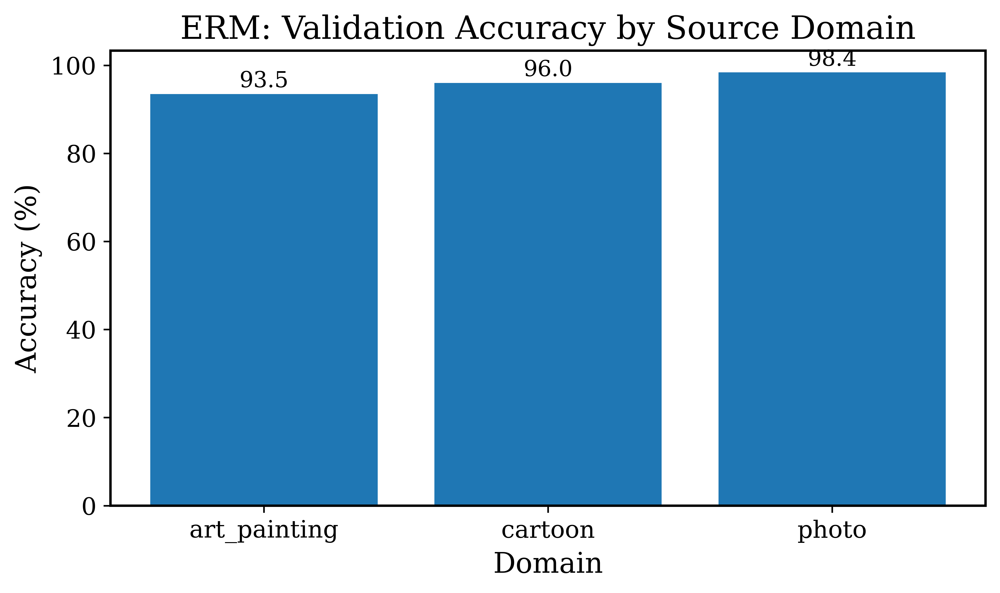

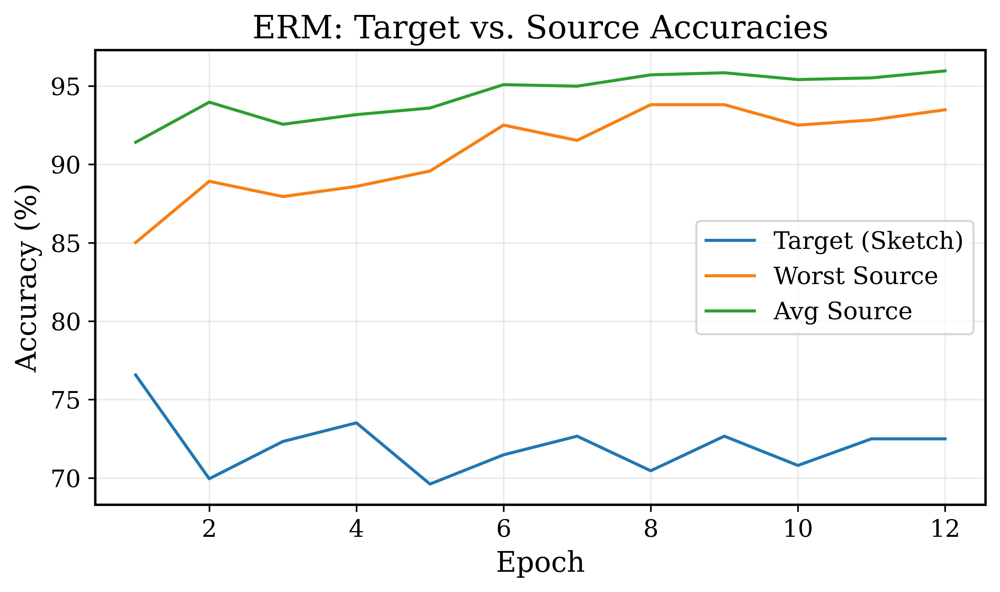

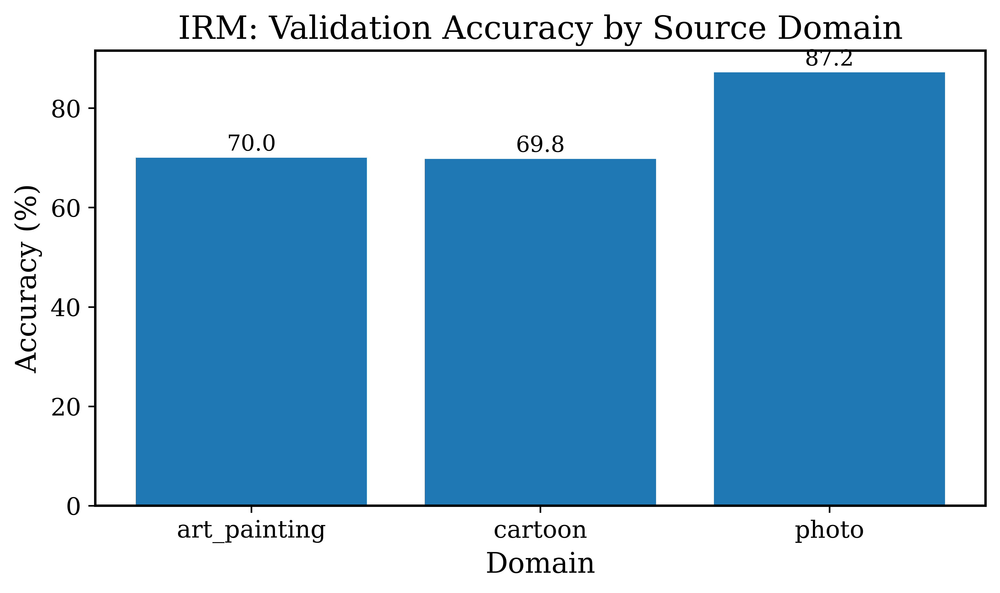

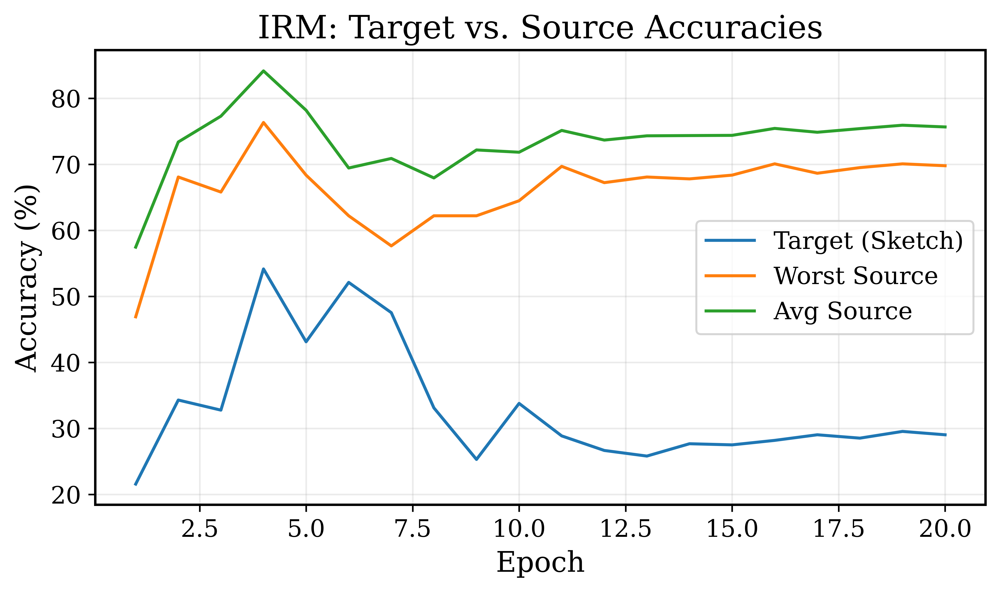

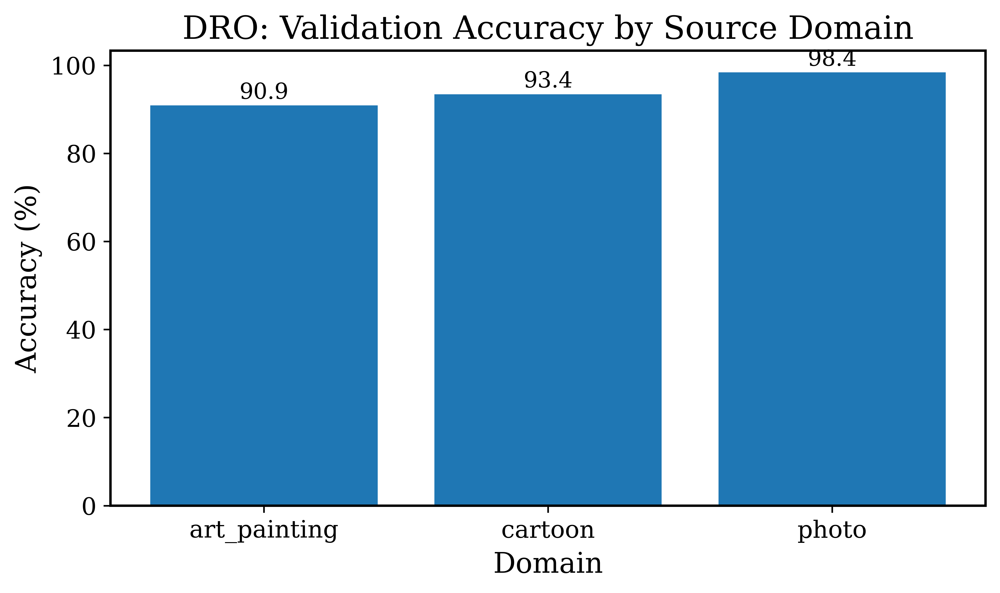

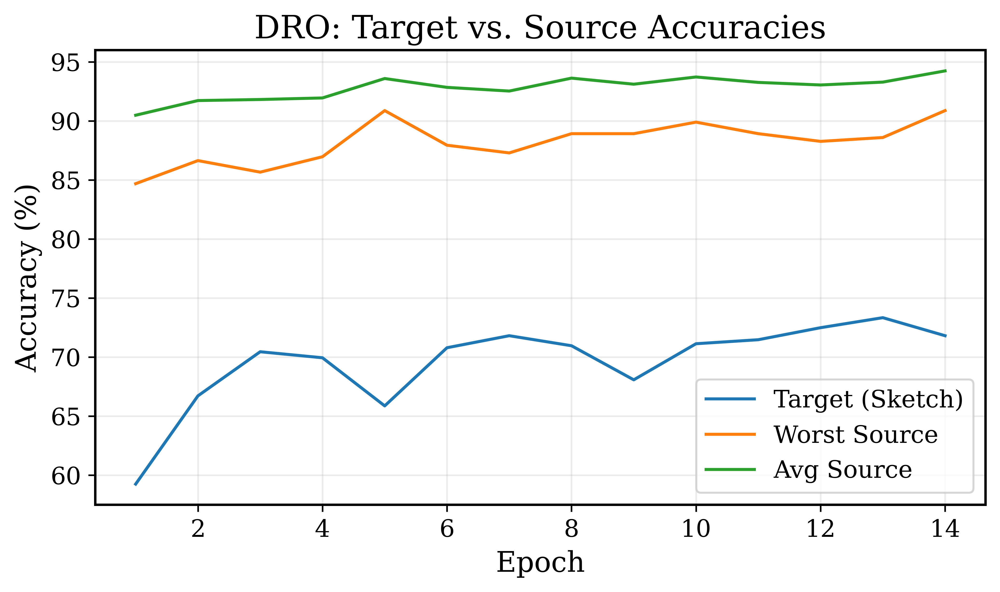

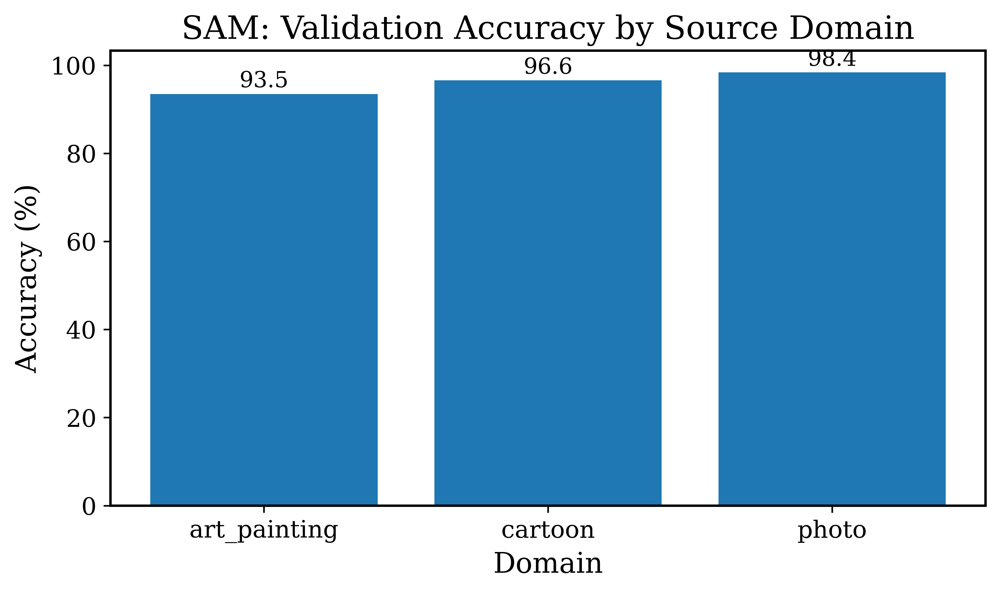

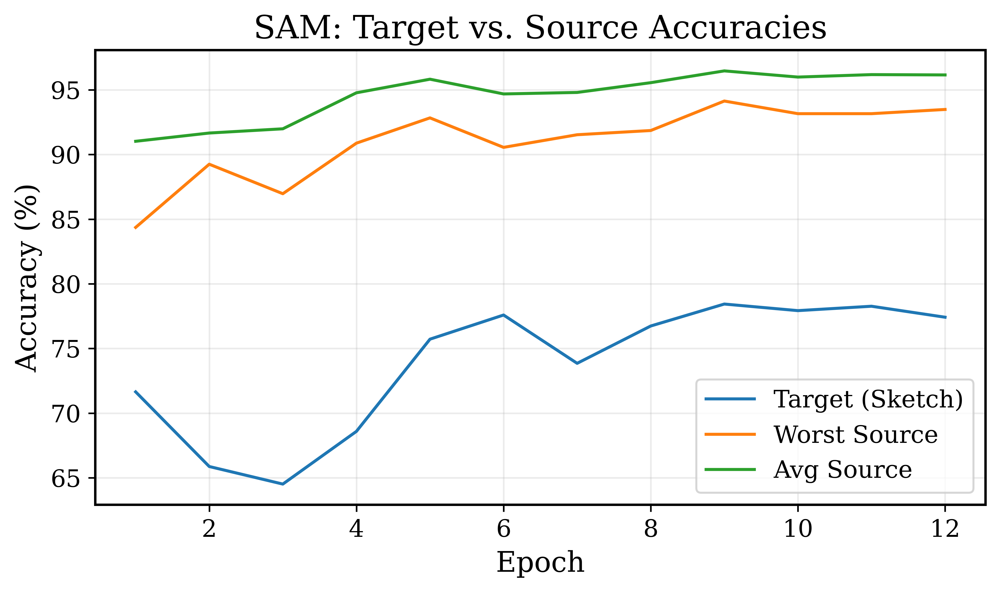


=== Task 2 Summary (percent) ===
method target_acc worst_source_acc avg_source_acc  src_acc_std  src_acc_range src_art_painting_acc src_cartoon_acc src_photo_acc
   ERM      72.50            93.49          95.97     0.020067       0.049147                93.49           96.01         98.40
   IRM      29.03            69.80          75.68     0.081480       0.173994                70.03           69.80         87.20
   DRO      71.82            90.88          94.24     0.031213       0.075205                90.88           93.45         98.40
   SAM      77.42            93.49          96.16     0.020289       0.049147                93.49           96.58         98.40


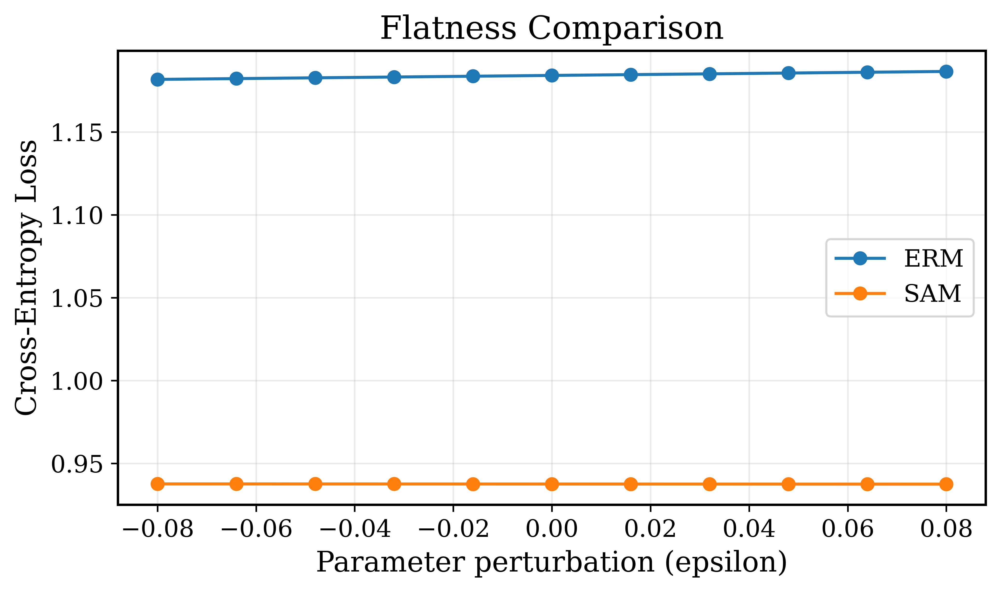

Logs  → outputs/PACS_Task2/logs
Figs  → outputs/PACS_Task2/figs
Ckpts → outputs/PACS_Task2/ckpts


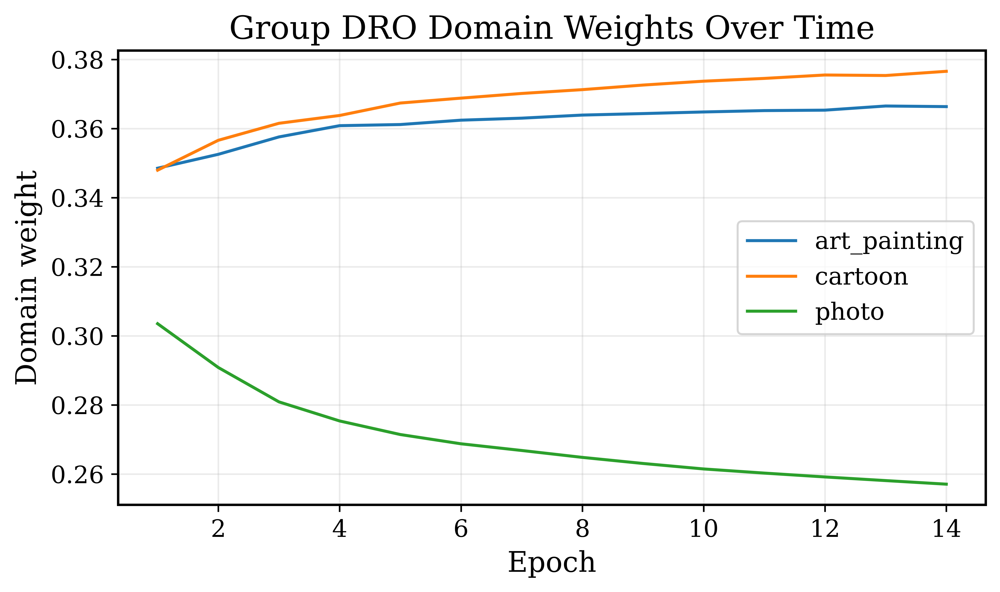

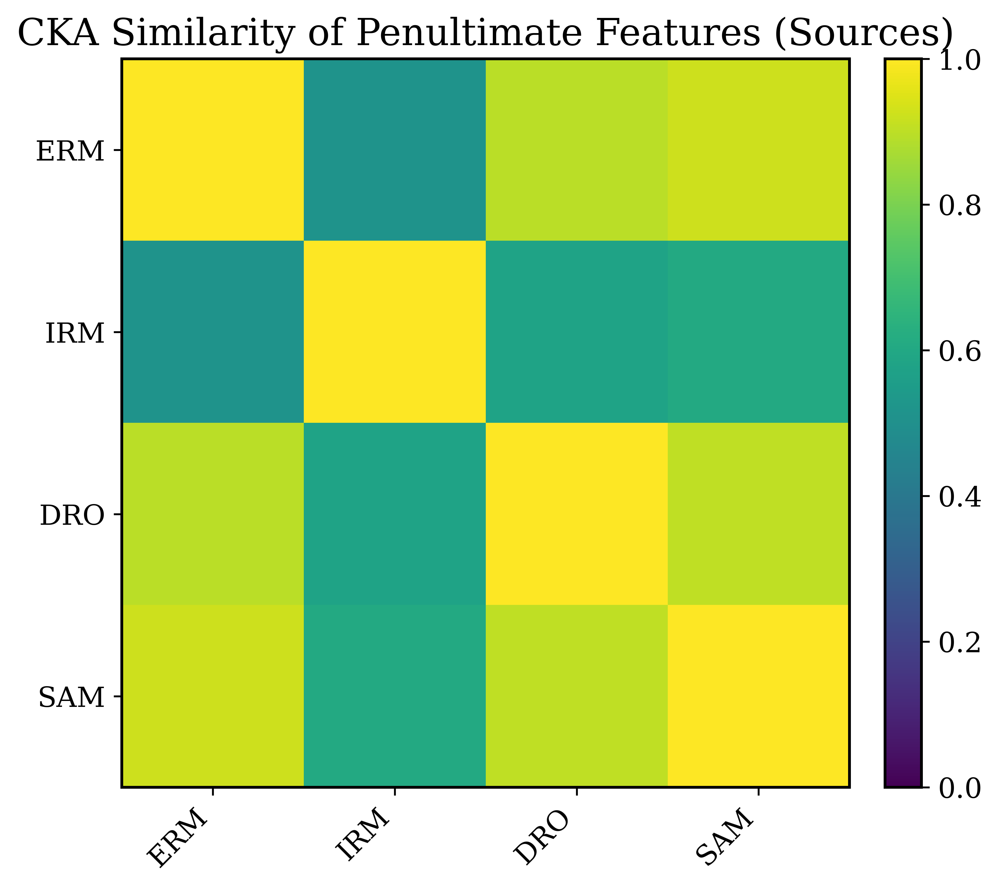

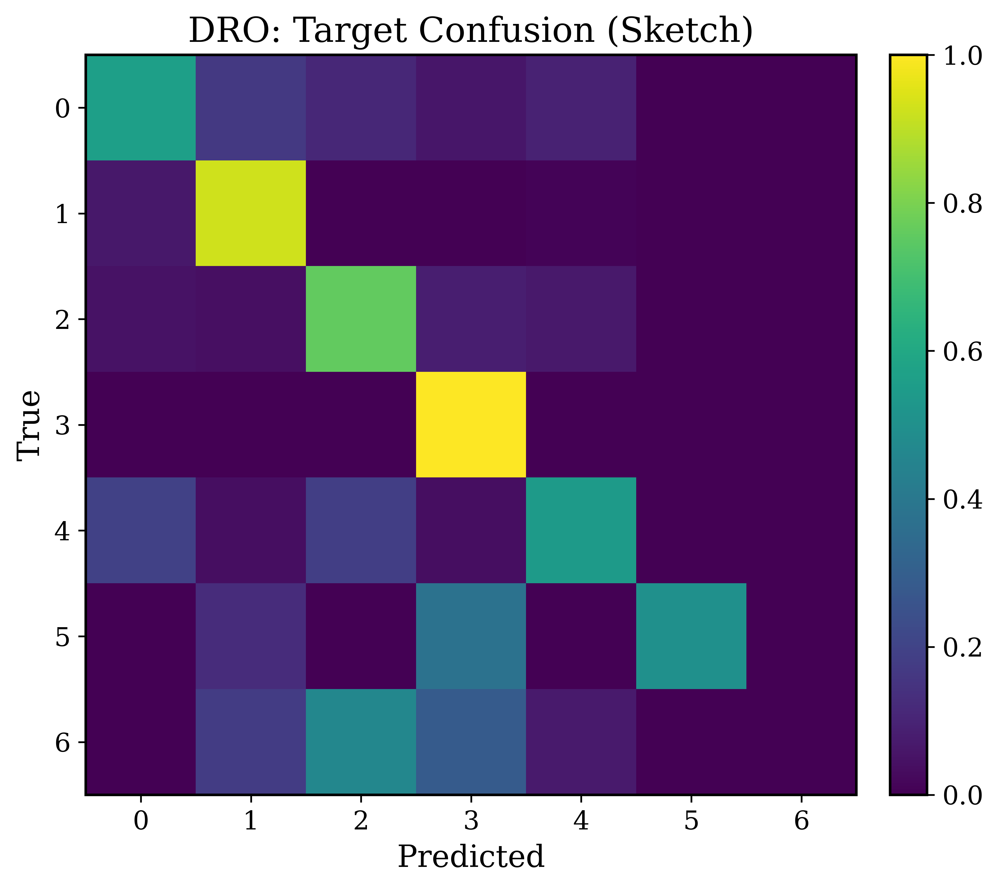

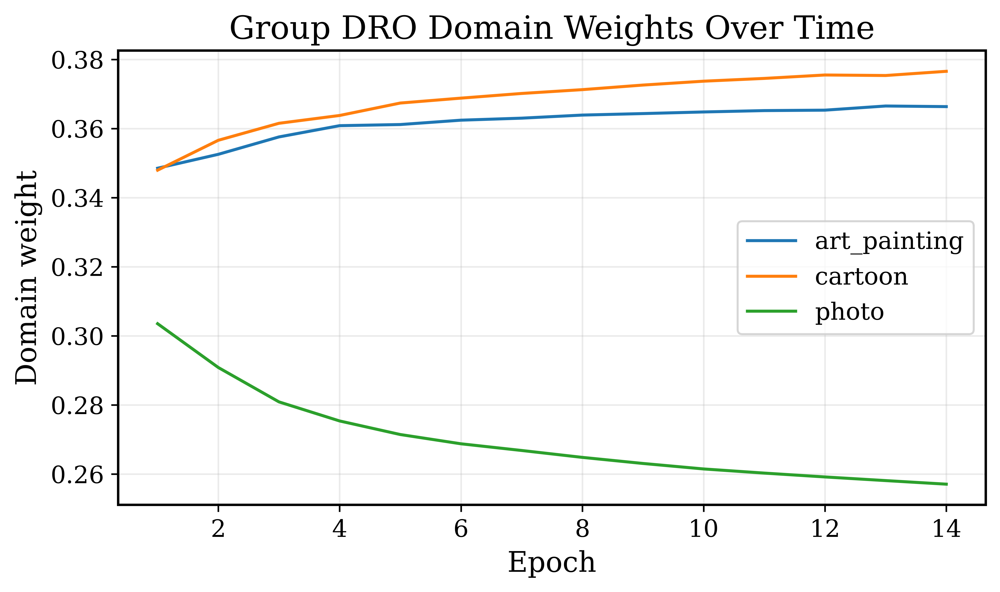

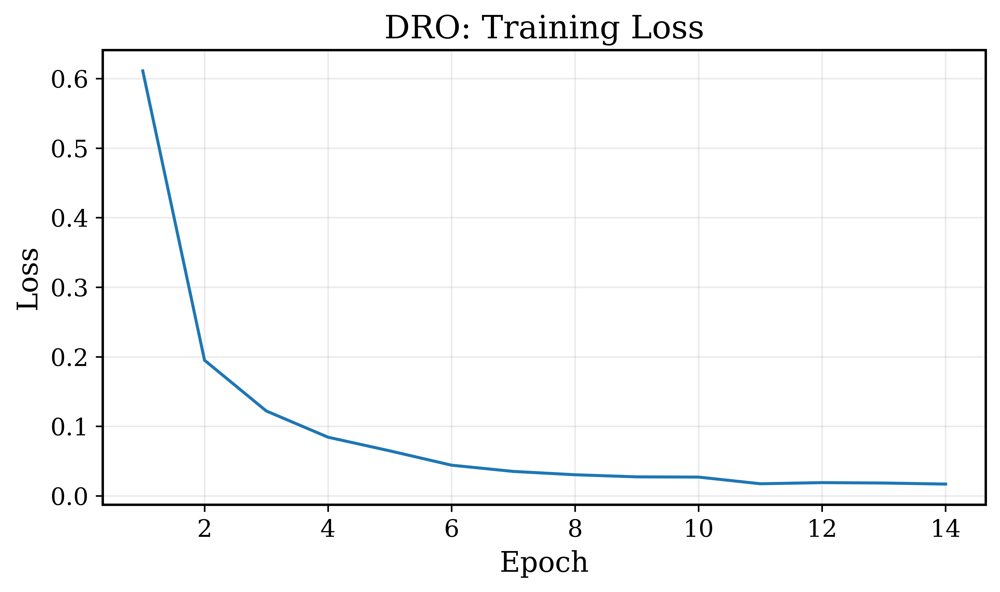

...

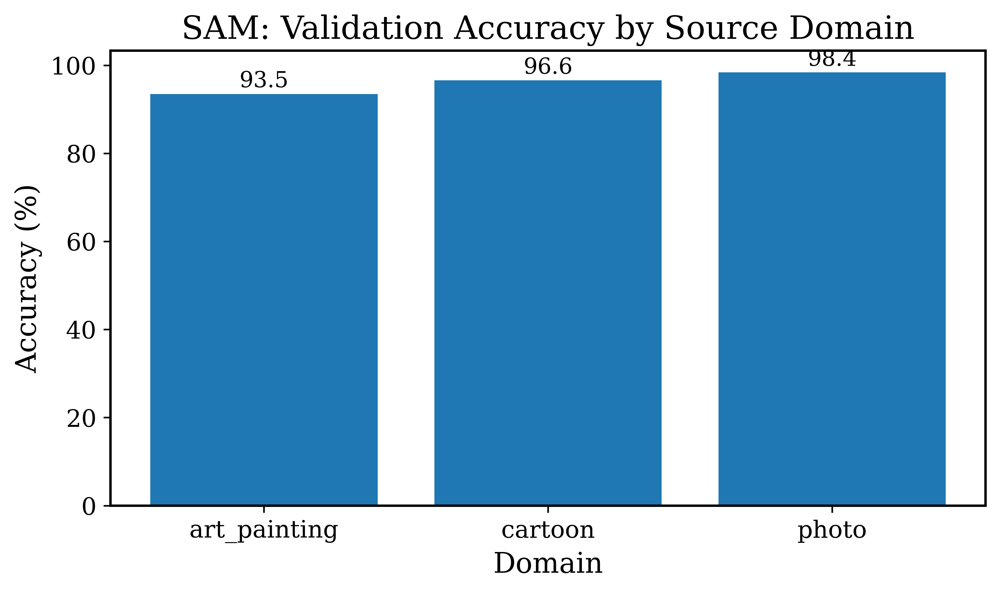

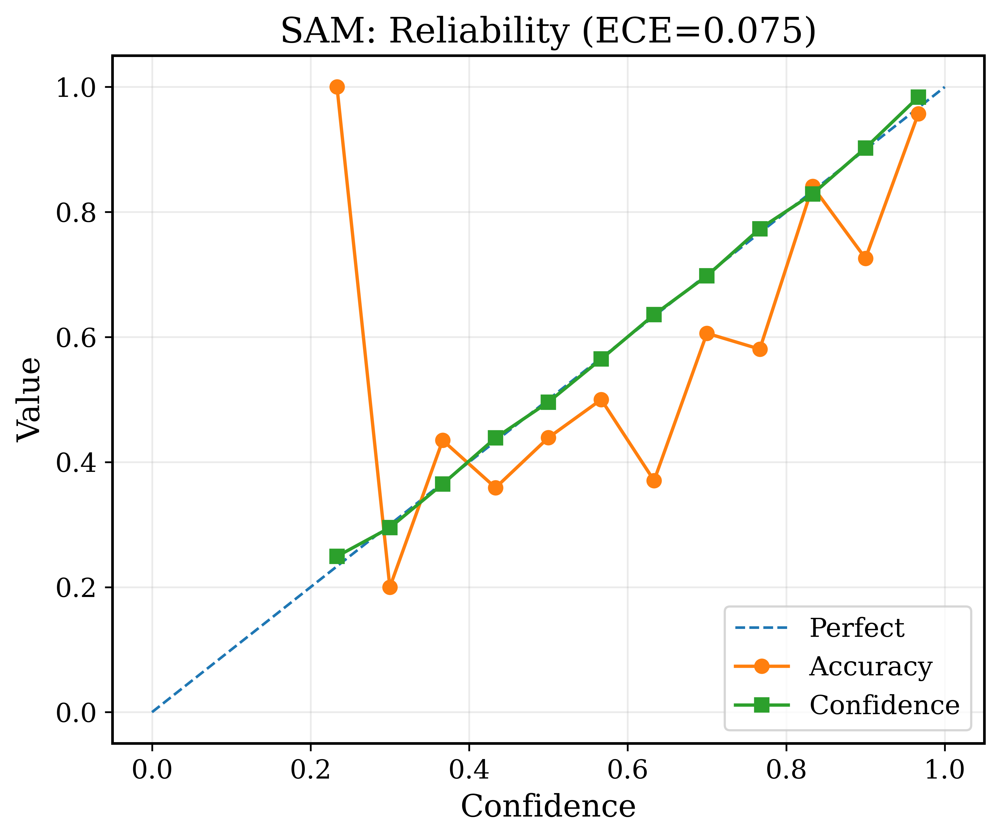

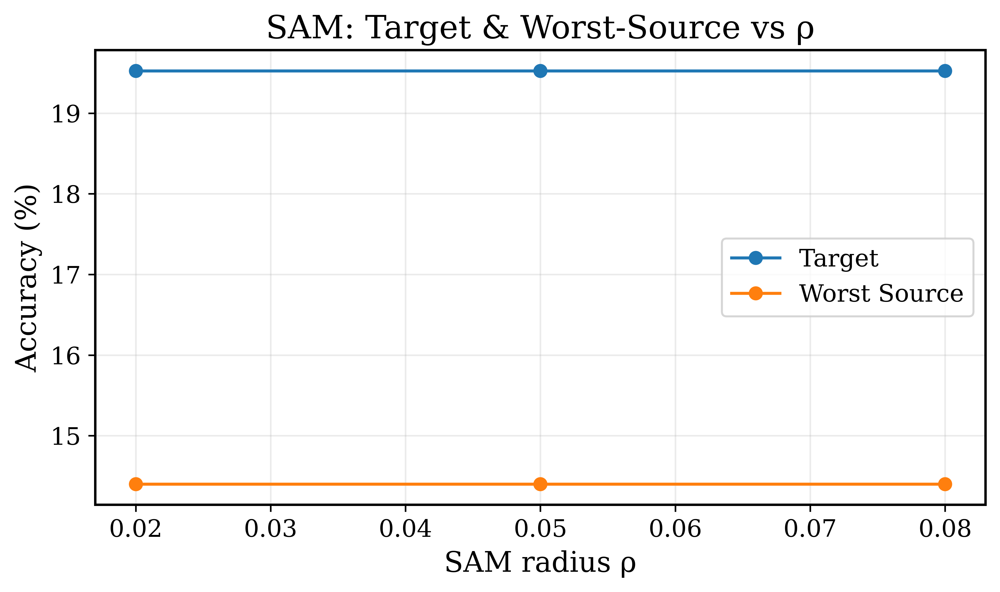

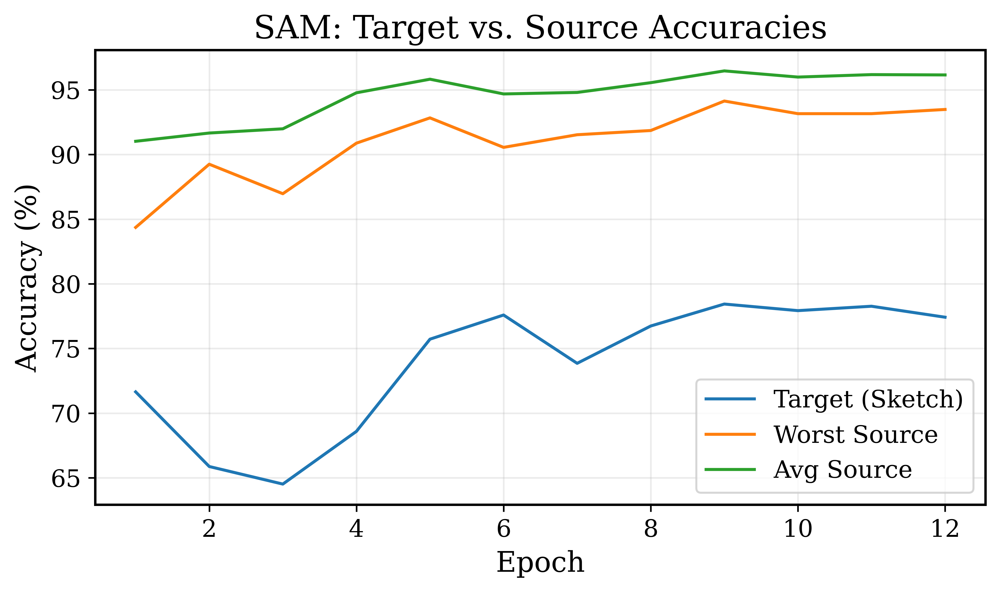

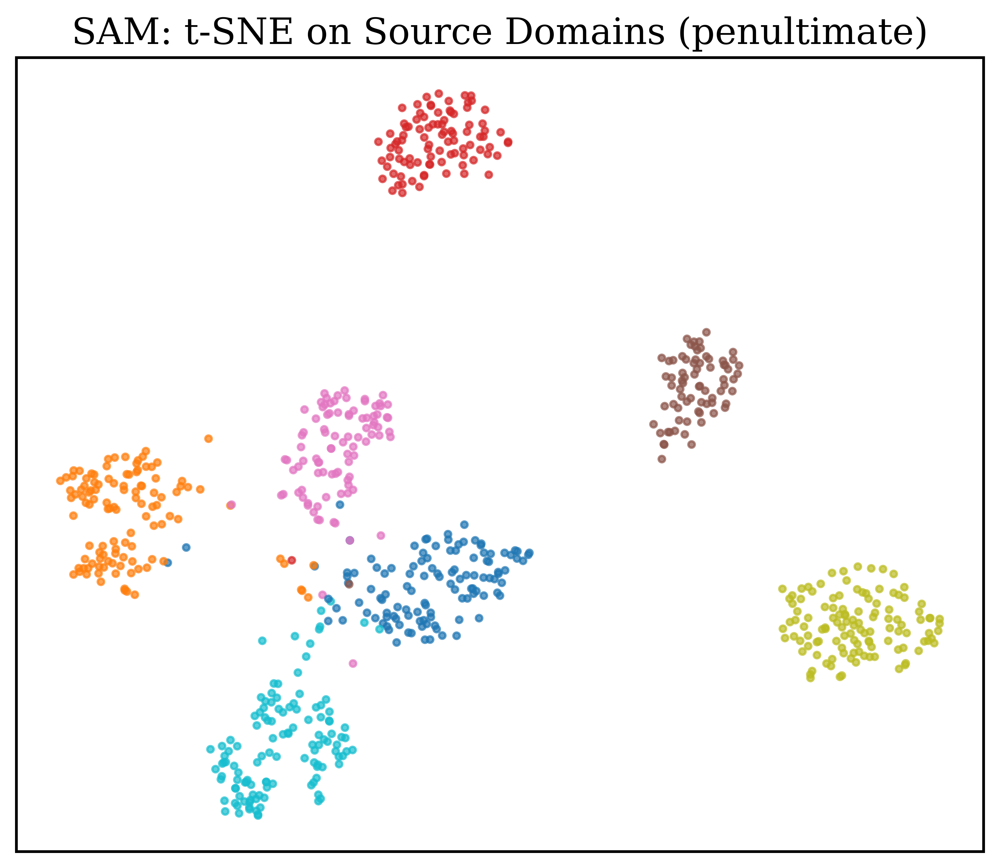

SAM(ρ=0.020) epoch 1:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.020) epoch 2:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.020) epoch 3:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.020) epoch 4:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.050) epoch 1:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.050) epoch 2:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.050) epoch 3:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.050) epoch 4:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.080) epoch 1:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.080) epoch 2:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.080) epoch 3:   0%|          | 0/80 [00:00<?, ?it/s]

SAM(ρ=0.080) epoch 4:   0%|          | 0/80 [00:00<?, ?it/s]


=== SAM ρ Sweep (percent) ===
 rho target_acc worst_source_acc avg_source_acc src_art_painting_acc src_cartoon_acc src_photo_acc
0.02      71.48            93.81          95.85                93.81           95.73         98.00
0.05      75.89            91.21          95.43                91.21           96.30         98.80
0.08      75.21            92.18          95.19                92.18           94.59         98.80


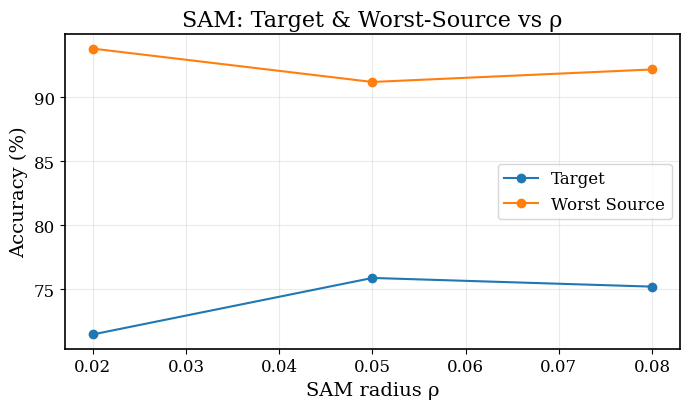

In [63]:
#cell 9
# run task 2 : erm -> irm -> dro -> sam, auto load checkpotns,  export figures and the summary csv for my use
RESUME_IF_CKPT_EXISTS = True  # keep resume for ERM/IRM/DRO to save time

# optional: wipe ONLY SAM checkpoints so training is clean
ck_dir = os.path.join(CFG["save_dir"], "ckpts")
os.makedirs(ck_dir, exist_ok=True)
for fn in list(os.listdir(ck_dir)):
    if fn.startswith("SAM_"):
        try: os.remove(os.path.join(ck_dir, fn))
        except: pass

# --- Train/Load ---
erm_model = train_ERM(domain_loaders, erm_loader)
irm_model = train_IRM(domain_loaders)
dro_model = train_GroupDRO(domain_loaders)

# turn off resume for SAM specifically
RESUME_IF_CKPT_EXISTS = False
sam_model = train_SAM(domain_loaders, erm_loader)
RESUME_IF_CKPT_EXISTS = True  # restore default

# --- Evaluate & Plot ---
methods = {"ERM": erm_model, "IRM": irm_model, "DRO": dro_model, "SAM": sam_model}
summary_rows = []

for name, model in methods.items():
    src_accs = evaluate_per_domain(model, source_val_loaders)
    worst_src = worst_domain_accuracy(src_accs)
    tgt_acc = evaluate(model, target_eval_loader)
    avg_src = float(np.mean(list(src_accs.values())))
    src_vals = list(src_accs.values())
    src_std  = float(np.std(src_vals))
    src_rng  = float(np.max(src_vals) - np.min(src_vals))

    # show & save plots inline
    plot_per_domain_acc(name, src_accs, CFG["save_dir"])                      # shows by default per your cell 8
    csv_path = os.path.join(CFG["save_dir"], "logs", f"{name}_logs.csv")
    if os.path.exists(csv_path):
        plot_training_curves(name, csv_path, CFG["save_dir"])
        # if you implemented plot_loss_curve/plot_irm_penalty with show=True, call them here as well:
        # plot_loss_curve(name, csv_path, CFG["save_dir"])
        # if name == "IRM": plot_irm_penalty(csv_path, CFG["save_dir"])

    row = {
        "method": name,
        "target_acc": tgt_acc,
        "worst_source_acc": worst_src,
        "avg_source_acc": avg_src,
        "src_acc_std": src_std,
        "src_acc_range": src_rng
    }
    row.update({f"src_{k}_acc": v for k, v in src_accs.items()})
    summary_rows.append(row)

# save/show summary
summary_df = pd.DataFrame(summary_rows)
summary_csv_path = os.path.join(CFG["save_dir"], "logs", "Task2_summary.csv")
summary_df.to_csv(summary_csv_path, index=False)

disp = summary_df.copy()
for c in disp.columns:
    if c.endswith("_acc") or c in ["target_acc", "worst_source_acc", "avg_source_acc"]:
        disp[c] = (disp[c] * 100.0).map(lambda x: f"{x:.2f}")
print("\n=== Task 2 Summary (percent) ===")
print(disp.to_string(index=False))

# Flatness: ERM vs SAM
plot_flatness_compare("ERM", erm_model, "SAM", sam_model, target_eval_loader, CFG["save_dir"])

print("Logs  →", os.path.join(CFG["save_dir"], "logs"))
print("Figs  →", os.path.join(CFG["save_dir"], "figs"))
print("Ckpts →", os.path.join(CFG["save_dir"], "ckpts"))

# DRO weights (inline)
plot_dro_weights(os.path.join(CFG["save_dir"], "logs", "DRO_domain_weights.csv"), CFG["save_dir"])

# quick inline gallery of saved figs
from IPython.display import display, Image
fig_dir = os.path.join(CFG["save_dir"], "figs")
for fn in sorted(os.listdir(fig_dir)):
    fp = os.path.join(fig_dir, fn)
    if os.path.isfile(fp) and fn.lower().endswith((".png", ".jpg", ".jpeg")):
        display(Image(filename=fp))

# --- SAM ρ SWEEP (fresh, no resume) ---
RESUME_IF_CKPT_EXISTS = False
sam_rows = run_sam_rho_sweep(domain_loaders, erm_loader, rhos=(0.02, 0.05, 0.08), max_epochs=4)
plot_sam_rho_sweep(sam_rows, CFG["save_dir"])
RESUME_IF_CKPT_EXISTS = True



In [64]:
# sanity checks for own use, one mni batch and a forward pass
x, y, d = next(iter(erm_loader))  # sample batch
print("Batch shapes:", x.shape, y.shape, d.shape)  # expect [B,3,224,224], [B], [B]
_test_model, _ = create_model(CFG["backbone"], CFG["num_classes"], CFG["finetune_all"])  # temp model
with torch.no_grad():
    logits = _test_model(x.to(DEVICE))
print("Logits shape:", logits.shape)  # expect [B, 7]
del _test_model
torch.cuda.empty_cache() if torch.cuda.is_available() else None


Batch shapes: torch.Size([64, 3, 224, 224]) torch.Size([64]) torch.Size([64])
Logits shape: torch.Size([64, 7])


In [65]:
#cell 10

from sklearn.manifold import TSNE  # for 2D embeddings
from sklearn.metrics import confusion_matrix  # for confusion matrices

def get_penultimate(model):  # grab penultimate layer module (avgpool output) for ResNet
    # for ResNet, penultimate features are the flattened output before fc
    return nn.Sequential(*(list(model.children())[:-1])).to(DEVICE)  # everything except final fc

@torch.no_grad()
def extract_features(model, loader, max_per_class=60):  # limit for speed and clean plots
    model.eval()  # eval mode
    feat_net = get_penultimate(model)  # feature trunk
    feats, ys, ds = [], [], []  # storages
    per_class_counts = {}  # to cap samples per class
    for x, y, d in loader:  # loop batches
        x = x.to(DEVICE, non_blocking=True)  # images
        y = y.to(DEVICE, non_blocking=True)  # labels
        f = feat_net(x).squeeze(-1).squeeze(-1)  # [B, C, 1, 1] -> [B, C]
        for i in range(f.size(0)):  # loop items
            c = int(y[i].item())  # class id
            per_class_counts[c] = per_class_counts.get(c, 0) + 1  # update count
            if per_class_counts[c] <= max_per_class:  # keep within limit
                feats.append(f[i].detach().cpu().numpy())  # add feat
                ys.append(c)  # add label
        # stop early if we gathered enough
        if len(feats) >= CFG["num_classes"] * max_per_class:  # enough per class
            break
    return np.array(feats), np.array(ys)  # arrays

@torch.no_grad()
def collect_target_predictions(model, loader):  # collect y_true and y_pred for target
    model.eval()  # eval
    y_true, y_pred = [], []  # lists
    for x, y, _ in loader:  # loop
        x = x.to(DEVICE, non_blocking=True)  # images
        logits = model(x)  # forward
        pred = logits.argmax(dim=1).detach().cpu().numpy()  # argmax
        y_true.extend(y.numpy().tolist())  # true
        y_pred.extend(pred.tolist())  # pred
    return np.array(y_true), np.array(y_pred)  # arrays

def class_names_from_loader(loader):  # recover ordered class names from ImageFolder subset
    # reach into the wrapped LocalSubset -> ImageFolder.samples -> class_to_idx mapping
    base_ds = loader.dataset  # LocalSubset or HF dataset wrapper
    # LocalSubset stores (path,label); we cannot read names from there, fallback to numeric names
    # so we return generic class names if actual names unavailable
    names = [f"class_{i}" for i in range(CFG['num_classes'])]  # generic
    try:
        # try to fetch from the underlying ImageFolder by peeking at one sample path
        # not always possible in HF path; safe fallback above
        pass
    except Exception:
        pass
    return names  # names list


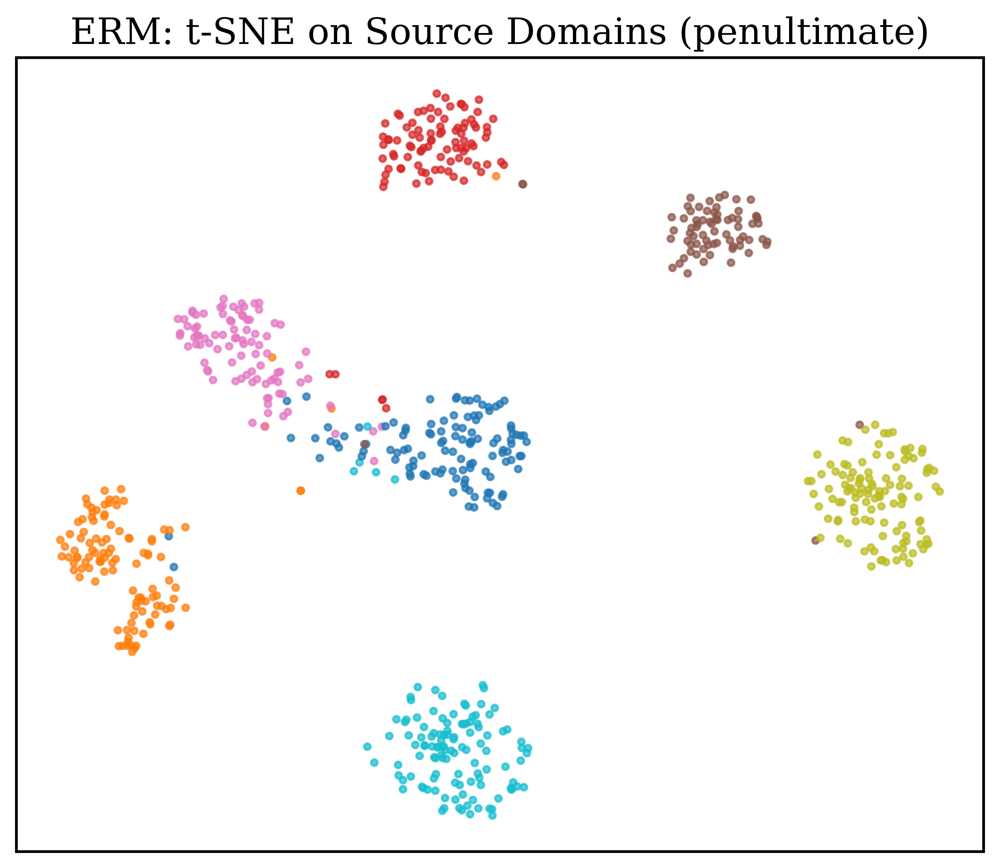

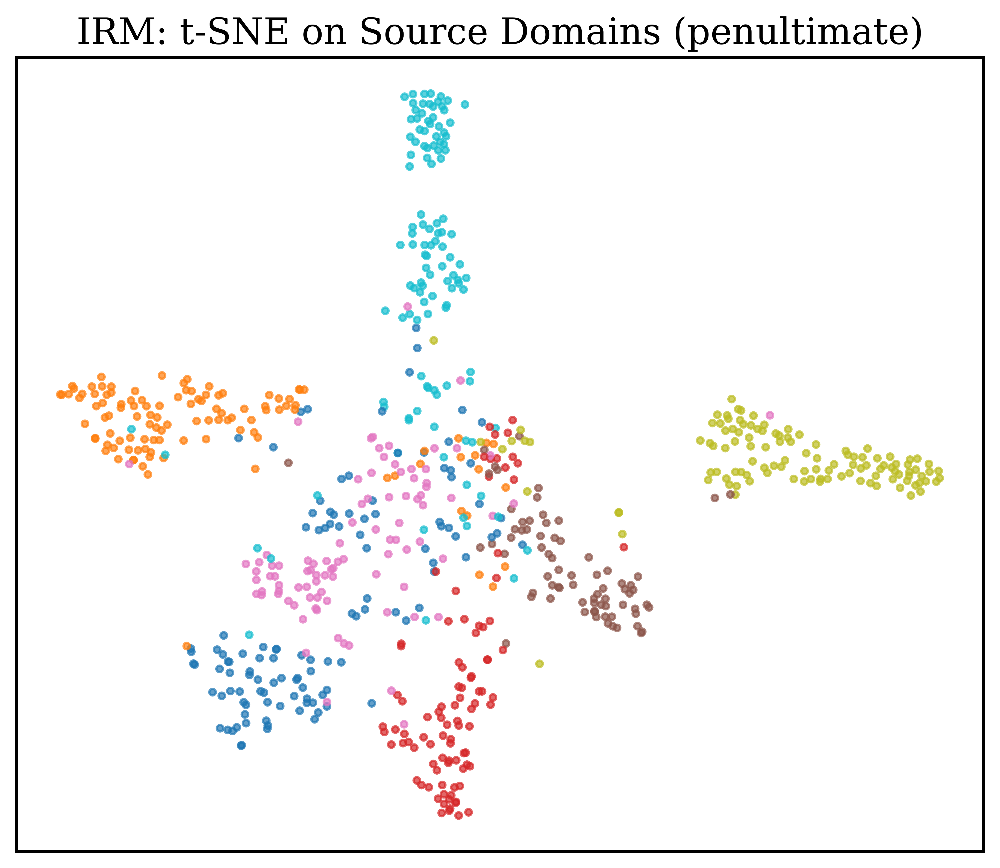

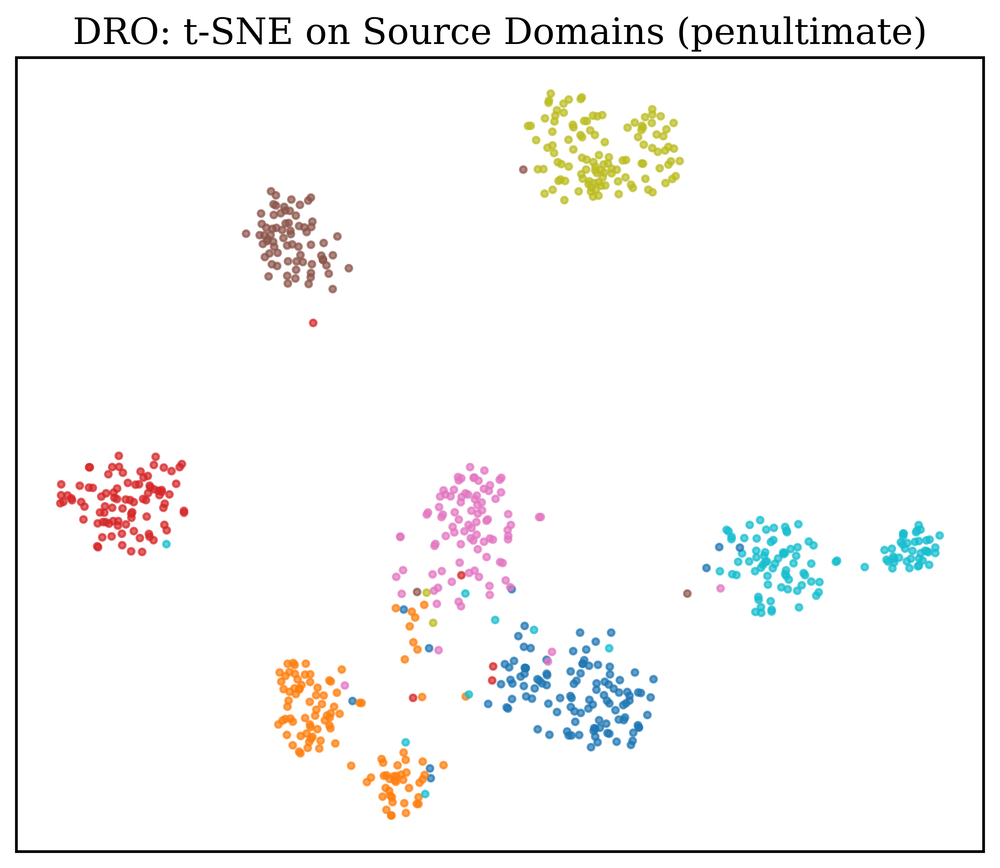

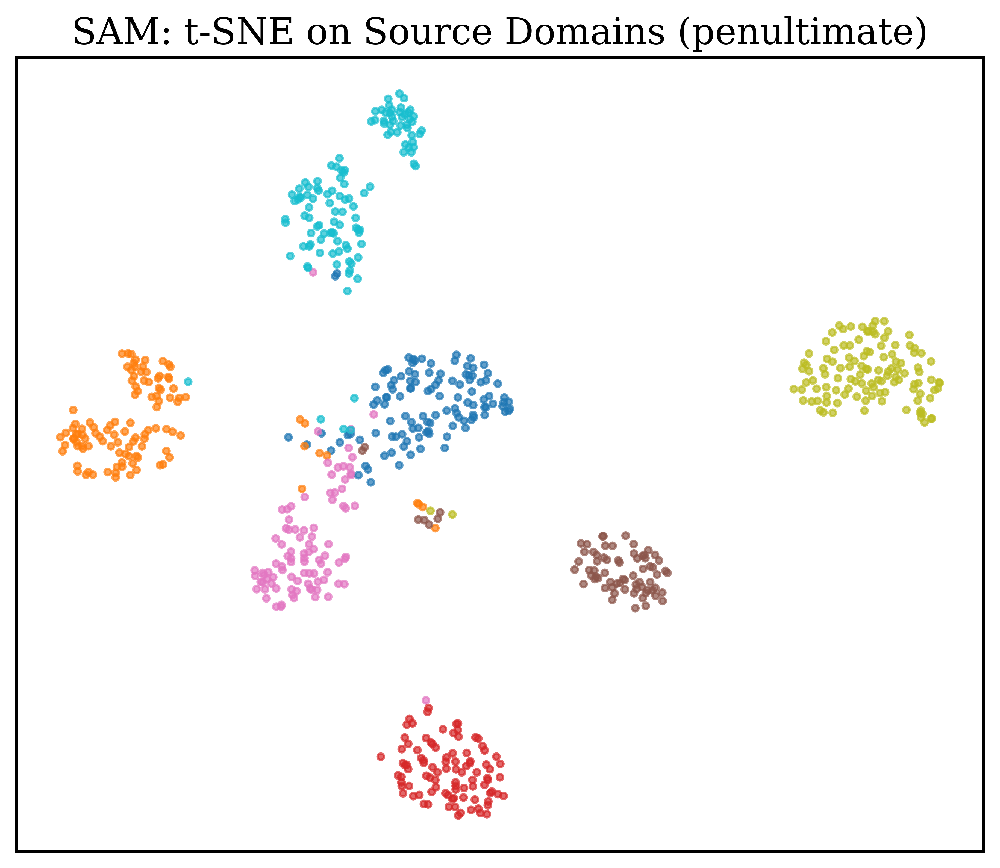

In [66]:
# cell 11
# t-SNE of penultimate features from a merged source validation set for each method

def tsne_plot_for_method(name, model, loaders_dict, save_dir):  # one plot per method
    # merge a few batches from each source domain val loader to a simple list
    merged_feats, merged_labels = [], []  # containers
    for dom in CFG["source_domains"]:  # each source domain
        feats, ys = extract_features(model, loaders_dict[dom], max_per_class=40)  # features
        merged_feats.append(feats)  # store feats
        merged_labels.append(ys)  # store labels
    X = np.concatenate(merged_feats, axis=0)  # all feats
    Y = np.concatenate(merged_labels, axis=0)  # all labels
    # run TSNE
    tsne = TSNE(n_components=2, init="pca", learning_rate="auto", perplexity=30, n_iter=1000, random_state=SEED)  # TSNE
    X2 = tsne.fit_transform(X)  # embed
    # plot colored by class
    plt.figure(figsize=(6.2, 5.4))  # figure size
    scatter = plt.scatter(X2[:,0], X2[:,1], c=Y, s=8, alpha=0.7, cmap="tab10")  # scatter
    plt.title(f"{name}: t-SNE on Source Domains (penultimate)", fontsize=16)  # title
    plt.xticks([])  # no ticks
    plt.yticks([])  # no ticks
    plt.tight_layout()  # layout
    out_path = os.path.join(save_dir, "figs", f"{name}_tsne_sources.png")  # path
    plt.savefig(out_path, dpi=600, bbox_inches="tight")  # save
    display(Image(filename=out_path))  # show
    plt.close()  # close

# run for all methods
for mname, m in methods.items():  # iterate methods
    tsne_plot_for_method(mname, m, source_val_loaders, CFG["save_dir"])  # plot

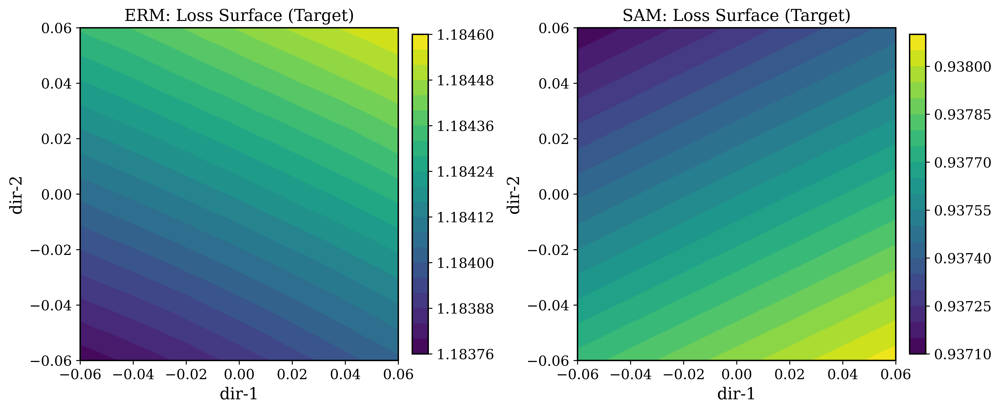

In [69]:
# cell 14
# 2D loss landscape visualization (Li et al. style) comparing ERM vs SAM on target

def _params_to_vector(model):  # flatten trainable params
    vec = []
    for p in model.parameters():
        if p.requires_grad:
            vec.append(p.detach().flatten())
    return torch.cat(vec)

def _vector_to_params_(model, vec):  # write back vector into params
    offset = 0
    for p in model.parameters():
        if p.requires_grad:
            n = p.numel()
            p.data.copy_(vec[offset:offset+n].view_as(p))
            offset += n

@torch.no_grad()
def loss_surface_2d(model, loader, grid=21, radius=0.05):  # coarse grid
    base = _params_to_vector(model).clone()  # current params
    d1 = torch.randn_like(base); d1 = d1 / (d1.norm() + 1e-12)  # dir1
    d2 = torch.randn_like(base); d2 = d2 / (d2.norm() + 1e-12)  # dir2
    xs = np.linspace(-radius, radius, grid)  # x coords
    ys = np.linspace(-radius, radius, grid)  # y coords
    Z = np.zeros((grid, grid), dtype=np.float32)  # loss grid
    # collect a small eval batch
    xs_batch, ys_batch = [], []
    for i, (x, y, _) in enumerate(loader):
        xs_batch.append(x); ys_batch.append(y)
        if i >= 2: break
    X = torch.cat(xs_batch).to(DEVICE); Y = torch.cat(ys_batch).to(DEVICE)
    # sweep grid
    for i, a in enumerate(xs):
        for j, b in enumerate(ys):
            new_vec = base + torch.tensor(a, device=DEVICE)*d1 + torch.tensor(b, device=DEVICE)*d2  # new params
            _vector_to_params_(model, new_vec)  # set params
            logits = model(X)  # forward
            Z[i,j] = F.cross_entropy(logits, Y).item()  # loss
    _vector_to_params_(model, base)  # restore
    return xs, ys, Z  # grid

def plot_surface_pair(mA_name, mA, mB_name, mB, loader, save_dir):  # plot both
    xs, ys, ZA = loss_surface_2d(mA, loader, grid=21, radius=0.06)  # ERM
    xb, yb, ZB = loss_surface_2d(mB, loader, grid=21, radius=0.06)  # SAM
    X, Y = np.meshgrid(xs, ys)  # mesh
    fig = plt.figure(figsize=(12, 5))  # fig
    # left: ERM
    ax1 = fig.add_subplot(1,2,1)  # subplot
    cs1 = ax1.contourf(X, Y, ZA.T, levels=20)  # contour
    fig.colorbar(cs1, ax=ax1, fraction=0.046, pad=0.04)  # colorbar
    ax1.set_title(f"{mA_name}: Loss Surface (Target)", fontsize=14)  # title
    ax1.set_xlabel("dir-1"); ax1.set_ylabel("dir-2")  # labels
    # right: SAM
    ax2 = fig.add_subplot(1,2,2)  # subplot
    cs2 = ax2.contourf(X, Y, ZB.T, levels=20)  # contour
    fig.colorbar(cs2, ax=ax2, fraction=0.046, pad=0.04)  # colorbar
    ax2.set_title(f"{mB_name}: Loss Surface (Target)", fontsize=14)  # title
    ax2.set_xlabel("dir-1"); ax2.set_ylabel("dir-2")  # labels
    plt.tight_layout()  # layout
    out_path = os.path.join(save_dir, "figs", f"LossSurface_{mA_name}_vs_{mB_name}.png")  # path
    plt.savefig(out_path, dpi=600, bbox_inches="tight")  # save
    display(Image(filename=out_path))  # show
    plt.close()  # close

# run for ERM vs SAM
plot_surface_pair("ERM", methods["ERM"], "SAM", methods["SAM"], target_eval_loader, CFG["save_dir"])  # plot

In [72]:
# cell 17
# export a LaTeX tabular for the main summary table (ready to paste in ICML LaTeX)

def latex_table_from_summary(summary_csv_path):  # build LaTeX tabular
    df = pd.read_csv(summary_csv_path)  # load
    cols = ["method", "target_acc", "worst_source_acc", "avg_source_acc"]  # key cols
    df2 = df[cols].copy()  # subset
    for c in cols[1:]:  # metrics
        df2[c] = (df2[c] * 100.0).map(lambda x: f"{x:.2f}")  # percent
    # latex
    tab = df2.to_latex(index=False, escape=False, column_format="lccc")  # latex string
    out_path = os.path.join(CFG["save_dir"], "logs", "Task2_table.tex")  # path
    with open(out_path, "w") as f:  # write
        f.write(tab)  # save
    print("LaTeX saved →", out_path)  # info
    print("\nPreview:\n")  # preview
    print(tab)  # print

latex_table_from_summary(os.path.join(CFG["save_dir"], "logs", "Task2_summary.csv"))  # run


LaTeX saved → outputs/PACS_Task2/logs/Task2_table.tex

Preview:

\begin{tabular}{lccc}
\toprule
method & target_acc & worst_source_acc & avg_source_acc \\
\midrule
ERM & 72.50 & 93.49 & 95.97 \\
IRM & 29.03 & 69.80 & 75.68 \\
DRO & 71.82 & 90.88 & 94.24 \\
SAM & 77.42 & 93.49 & 96.16 \\
\bottomrule
\end{tabular}



In [73]:
# #zipping and downloading outputs (models, logs, figs,)
# from google.colab import files  # colab files API
# import subprocess as sp  # shell

# root = CFG["save_dir"]  # output root
# zip_path = "/content/PACS_Task2_outputs.zip"  # zip file path
# if os.path.exists(zip_path):
#     os.remove(zip_path)
# sp.run(["zip", "-r", zip_path, root], check=True)
# print("Zipped:", zip_path)
# files.download(zip_path)
